In [1]:
!pip install --upgrade kneed


In [2]:
pip install missingno

Note: you may need to restart the kernel to use updated packages.


In [3]:
!pip install yellowbrick

In [4]:
pip install clusteval


In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from kneed import KneeLocator
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score , silhouette_samples
from yellowbrick.cluster import SilhouetteVisualizer

import matplotlib.cm as cm
from sklearn.preprocessing import StandardScaler , LabelEncoder
import missingno as msno
import plotly.express as px
import scipy.stats as stat
import pylab
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.cluster import DBSCAN , AgglomerativeClustering,  SpectralClustering
from sklearn import metrics
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer
from clusteval import clusteval
from scipy.stats import pearsonr
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score


import plotly.express as px
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

sns.set(rc = {'figure.figsize':(15,8)})


In [6]:
data = pd.read_csv(r"C:\Users\ASUS\PycharmProjects\pythonProject2\CLIENT.csv", sep =";")


In [7]:
pd.set_option("display.max.columns", None)

In [8]:
data.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PACK_BABY,CLIENT_NOMBRE_PACK_BUSINESS,CLIENT_NOMBRE_PACK_ELITE,CLIENT_NOMBRE_PACK_ELITE_PRO,CLIENT_NOMBRE_PACK_EPARGNE,CLIENT_NOMBRE_PACK_EXPRESS,CLIENT_NOMBRE_PACK_FIRST,CLIENT_NOMBRE_PACK_NAJAH,CLIENT_NOMBRE_PACK_PLATI_PRO,CLIENT_NOMBRE_PACK_PLATIN,CLIENT_NOMBRE_PACK_SAFIR,CLIENT_NOMBRE_PACK_SAFIR_PRO,CLIENT_NOMBRE_PACK_SILVER,CLIENT_NOMBRE_PACK_TOUN,CLIENT_NOMBRE_PACK_TOUN_DVS,CLIENT_NOMBRE_PACK_UNIV,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR
0,178601,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,51.0,Activites juridiques,0,"27713,798",FALSE,AUTRE,"916,666",1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,Directeurs d'entreprises,900,CLIENT_A_VUE,0,1
1,98070,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58.0,Autres activites manufacturieres n.c.a.,0,"84,396",NON,AUTRE,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,Directeurs d'entreprises,NaN,CLIENT_A_VUE,0,1
2,454569,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57.0,Coiffure et soins de beaute,"3013,95","849,304",NON,AUTRE,"1252,316",0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,Directeurs d'Ã©tablissements d'enseignement et...,538,CLIENT_A_VUE,"2933,30905",1
3,40717,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,52.0,Commerce de detail de tabac,0,"783,062",NON,AUTRE,"1748,31",0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,"349,79515",1
4,442731,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58.0,Commerce de gros d'equipements pour la constru...,"631,94",0,NON,AUTRE,"216,331",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,"1373,05",1


In [9]:
data.tail()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PACK_BABY,CLIENT_NOMBRE_PACK_BUSINESS,CLIENT_NOMBRE_PACK_ELITE,CLIENT_NOMBRE_PACK_ELITE_PRO,CLIENT_NOMBRE_PACK_EPARGNE,CLIENT_NOMBRE_PACK_EXPRESS,CLIENT_NOMBRE_PACK_FIRST,CLIENT_NOMBRE_PACK_NAJAH,CLIENT_NOMBRE_PACK_PLATI_PRO,CLIENT_NOMBRE_PACK_PLATIN,CLIENT_NOMBRE_PACK_SAFIR,CLIENT_NOMBRE_PACK_SAFIR_PRO,CLIENT_NOMBRE_PACK_SILVER,CLIENT_NOMBRE_PACK_TOUN,CLIENT_NOMBRE_PACK_TOUN_DVS,CLIENT_NOMBRE_PACK_UNIV,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR
834748,907048,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,39.0,Transports maritimes,0,0,FALSE,AUTRE,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Conducteurs dans le transport de marchandises,1000,CLIENT_EXCLUSIF_EPARGNE,"68,2356",1
834749,220819,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,51.0,Transports maritimes,0,0,NON,AUTRE,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,CommerÃ§ants (autres),2000,CLIENT_PLACEUR,"1036,8706047608",1
834750,292399,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,45.0,Transports maritimes,0,0,NON,AUTRE,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Artisans (autres),1500,CLIENT_EXCLUSIF_EPARGNE,"1724,58635",1
834751,607524,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,38.0,Transports maritimes,0,"284,391",FALSE,AUTRE,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Conducteurs dans le transport de marchandises,1200,CLIENT_A_VUE,"17,43685",1
834752,401767,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,42.0,Transports maritimes,0,"617,537",FALSE,AUTRE,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Chauffeurs de taxis et conducteurs d'automobil...,4000,CLIENT_A_VUE,"1495,50345",1


In [10]:
data.shape

(834753, 40)

In [11]:
data.columns

Index(['CLIENT_ID', 'AGENCE', 'MARCHE', 'SEGMENT', 'SOUS SEGMENT',
       'CLIENT_AGE', 'CLIENT_ACTIVITE', 'CLIENT_ENCOURS_A_VUE',
       'CLIENT_ENCOURS_ENGAGEMENT', 'CLIENT_ENROLES', 'CLIENT_ENTREE_FINAL',
       'CLIENT_MMM', 'CLIENT_NOMBRE_BIATNET', 'CLIENT_NOMBRE_CARTES',
       'CLIENT_NOMBRE_MESSAGIS', 'CLIENT_NOMBRE_FAMILIA',
       'CLIENT_NOMBRE_OPCVM', 'CLIENT_NOMBRE_PACK_BABY',
       'CLIENT_NOMBRE_PACK_BUSINESS', 'CLIENT_NOMBRE_PACK_ELITE',
       'CLIENT_NOMBRE_PACK_ELITE_PRO', 'CLIENT_NOMBRE_PACK_EPARGNE',
       'CLIENT_NOMBRE_PACK_EXPRESS', 'CLIENT_NOMBRE_PACK_FIRST',
       'CLIENT_NOMBRE_PACK_NAJAH', 'CLIENT_NOMBRE_PACK_PLATI_PRO',
       'CLIENT_NOMBRE_PACK_PLATIN', 'CLIENT_NOMBRE_PACK_SAFIR',
       'CLIENT_NOMBRE_PACK_SAFIR_PRO', 'CLIENT_NOMBRE_PACK_SILVER',
       'CLIENT_NOMBRE_PACK_TOUN', 'CLIENT_NOMBRE_PACK_TOUN_DVS',
       'CLIENT_NOMBRE_PACK_UNIV', 'CLIENT_NOMBRE_PROJET_AVENIR',
       'CLIENT_NOMBRE_TITRES', 'CLIENT_PROFESSION',
       'CLIENT_REVENUS_MEN

In [12]:
data.nunique()

CLIENT_ID                       834753
AGENCE                             205
MARCHE                               2
SEGMENT                              8
SOUS SEGMENT                        21
CLIENT_AGE                         130
CLIENT_ACTIVITE                    495
CLIENT_ENCOURS_A_VUE            178887
CLIENT_ENCOURS_ENGAGEMENT       196759
CLIENT_ENROLES                       3
CLIENT_ENTREE_FINAL                  2
CLIENT_MMM                      265249
CLIENT_NOMBRE_BIATNET                4
CLIENT_NOMBRE_CARTES                13
CLIENT_NOMBRE_MESSAGIS               5
CLIENT_NOMBRE_FAMILIA                1
CLIENT_NOMBRE_OPCVM                  6
CLIENT_NOMBRE_PACK_BABY              2
CLIENT_NOMBRE_PACK_BUSINESS          1
CLIENT_NOMBRE_PACK_ELITE             2
CLIENT_NOMBRE_PACK_ELITE_PRO         3
CLIENT_NOMBRE_PACK_EPARGNE           5
CLIENT_NOMBRE_PACK_EXPRESS           2
CLIENT_NOMBRE_PACK_FIRST             2
CLIENT_NOMBRE_PACK_NAJAH             2
CLIENT_NOMBRE_PACK_PLATI_

In [13]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CLIENT_ID,834753.0,717565.397967,420865.999812,3483.0,345176.0,723009.0,1083404.0,1437819.0
CLIENT_AGE,834458.0,41.081504,17.739650,0.0,29.0,39.0,53.0,830.0
CLIENT_NOMBRE_BIATNET,834753.0,0.144277,0.353207,0.0,0.0,0.0,0.0,3.0
CLIENT_NOMBRE_CARTES,834753.0,0.790131,1.010019,0.0,0.0,0.0,1.0,72.0
CLIENT_NOMBRE_MESSAGIS,834753.0,0.130533,0.340828,0.0,0.0,0.0,0.0,5.0
CLIENT_NOMBRE_FAMILIA,834753.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
CLIENT_NOMBRE_OPCVM,834753.0,0.004579,0.071576,0.0,0.0,0.0,0.0,5.0
CLIENT_NOMBRE_PACK_BABY,834753.0,0.036419,0.187331,0.0,0.0,0.0,0.0,1.0
CLIENT_NOMBRE_PACK_BUSINESS,834753.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
CLIENT_NOMBRE_PACK_ELITE,834753.0,0.005075,0.071055,0.0,0.0,0.0,0.0,1.0


### Checking missing values

In [14]:
data.isnull().any()

CLIENT_ID                       False
AGENCE                           True
MARCHE                          False
SEGMENT                          True
SOUS SEGMENT                     True
CLIENT_AGE                       True
CLIENT_ACTIVITE                 False
CLIENT_ENCOURS_A_VUE            False
CLIENT_ENCOURS_ENGAGEMENT       False
CLIENT_ENROLES                  False
CLIENT_ENTREE_FINAL             False
CLIENT_MMM                      False
CLIENT_NOMBRE_BIATNET           False
CLIENT_NOMBRE_CARTES            False
CLIENT_NOMBRE_MESSAGIS          False
CLIENT_NOMBRE_FAMILIA           False
CLIENT_NOMBRE_OPCVM             False
CLIENT_NOMBRE_PACK_BABY         False
CLIENT_NOMBRE_PACK_BUSINESS     False
CLIENT_NOMBRE_PACK_ELITE        False
CLIENT_NOMBRE_PACK_ELITE_PRO    False
CLIENT_NOMBRE_PACK_EPARGNE      False
CLIENT_NOMBRE_PACK_EXPRESS      False
CLIENT_NOMBRE_PACK_FIRST        False
CLIENT_NOMBRE_PACK_NAJAH        False
CLIENT_NOMBRE_PACK_PLATI_PRO    False
CLIENT_NOMBR

--> The columns with numeric values 'CLIENT_AGE' , 'CLIENT_REVENUS_MENSUELS_NETS' contain null values

<AxesSubplot:>

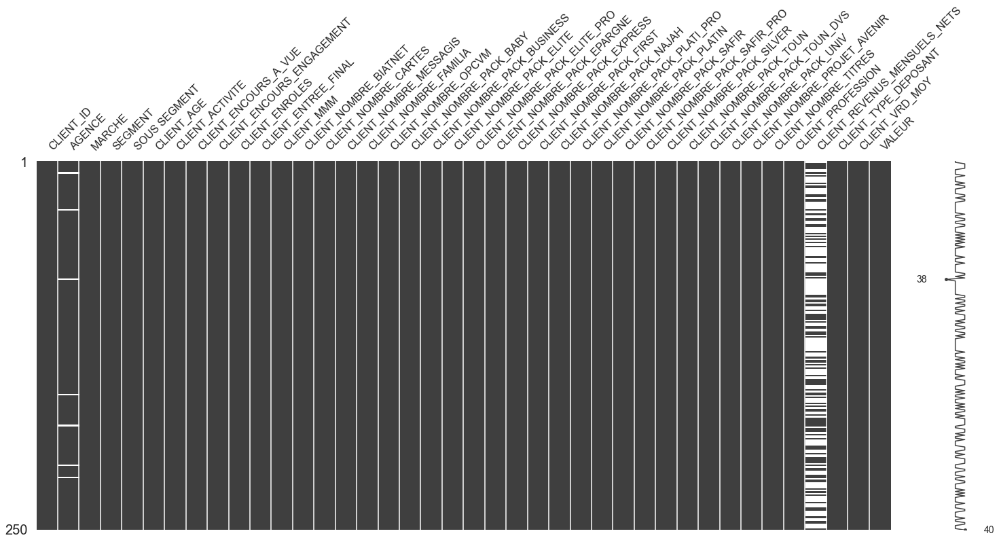

In [15]:
%matplotlib inline
msno.matrix(data.sample(250))

In [16]:
data = data.dropna(subset=['CLIENT_AGE','CLIENT_NOMBRE_OPCVM'])

In [17]:
#Assigning types to data
print (data.info())
data.CLIENT_ID = data.CLIENT_ID.astype('int')
data.CLIENT_AGE = data.CLIENT_AGE.astype('int')
data.CLIENT_ENCOURS_A_VUE = data.CLIENT_ENCOURS_A_VUE.replace(',','.', regex=True).astype('float')
data.CLIENT_ENCOURS_ENGAGEMENT = data.CLIENT_ENCOURS_ENGAGEMENT.replace(',','.', regex=True).astype('float')
data.CLIENT_MMM = data.CLIENT_MMM.replace(',','.', regex=True).astype('float')
data.CLIENT_REVENUS_MENSUELS_NETS = data.CLIENT_REVENUS_MENSUELS_NETS.replace(',','.', regex=True).astype('float')
data.CLIENT_VRD_MOY = data.CLIENT_VRD_MOY.replace(',','.', regex=True).astype('float')
data.CLIENT_NOMBRE_PACK_BABY = data.CLIENT_NOMBRE_PACK_BABY.astype('int')
data.CLIENT_NOMBRE_PACK_BUSINESS = data.CLIENT_NOMBRE_PACK_BUSINESS.astype('int')
data.CLIENT_NOMBRE_PACK_ELITE = data.CLIENT_NOMBRE_PACK_ELITE.astype('int')
data.CLIENT_NOMBRE_PACK_ELITE_PRO = data.CLIENT_NOMBRE_PACK_ELITE_PRO.astype('int')
data.CLIENT_NOMBRE_PACK_EPARGNE = data.CLIENT_NOMBRE_PACK_EPARGNE.astype('int')
data.CLIENT_NOMBRE_PACK_EXPRESS = data.CLIENT_NOMBRE_PACK_EXPRESS.astype('int')
data.CLIENT_NOMBRE_PACK_FIRST = data.CLIENT_NOMBRE_PACK_FIRST.astype('int')
data.CLIENT_NOMBRE_PACK_NAJAH = data.CLIENT_NOMBRE_PACK_NAJAH.astype('int')
data.CLIENT_NOMBRE_PACK_PLATI_PRO = data.CLIENT_NOMBRE_PACK_PLATI_PRO.astype('int')
data.CLIENT_NOMBRE_PACK_PLATIN = data.CLIENT_NOMBRE_PACK_PLATIN.astype('int')
data.CLIENT_NOMBRE_PACK_SAFIR = data.CLIENT_NOMBRE_PACK_SAFIR.astype('int')
data.CLIENT_NOMBRE_PACK_SAFIR_PRO = data.CLIENT_NOMBRE_PACK_SAFIR_PRO.astype('int')
data.CLIENT_NOMBRE_PACK_TOUN = data.CLIENT_NOMBRE_PACK_TOUN.astype('int')
data.CLIENT_NOMBRE_PACK_TOUN_DVS = data.CLIENT_NOMBRE_PACK_TOUN_DVS.astype('int')
data.CLIENT_NOMBRE_PACK_UNIV = data.CLIENT_NOMBRE_PACK_UNIV.astype('int')
data.CLIENT_NOMBRE_PACK_SILVER = data.CLIENT_NOMBRE_PACK_SILVER.astype('int')
data.CLIENT_NOMBRE_OPCVM = data.CLIENT_NOMBRE_OPCVM.astype('int')
data.CLIENT_NOMBRE_TITRES = data.CLIENT_NOMBRE_TITRES.astype('int')
data.CLIENT_NOMBRE_CARTES = data.CLIENT_NOMBRE_CARTES.astype('int')
data.CLIENT_NOMBRE_BIATNET = data.CLIENT_NOMBRE_BIATNET.astype('int')
data.CLIENT_NOMBRE_PROJET_AVENIR = data.CLIENT_NOMBRE_PROJET_AVENIR.astype('int')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 834458 entries, 0 to 834752
Data columns (total 40 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   CLIENT_ID                     834458 non-null  int64  
 1   AGENCE                        817920 non-null  object 
 2   MARCHE                        834458 non-null  object 
 3   SEGMENT                       834457 non-null  object 
 4   SOUS SEGMENT                  834457 non-null  object 
 5   CLIENT_AGE                    834458 non-null  float64
 6   CLIENT_ACTIVITE               834458 non-null  object 
 7   CLIENT_ENCOURS_A_VUE          834458 non-null  object 
 8   CLIENT_ENCOURS_ENGAGEMENT     834458 non-null  object 
 9   CLIENT_ENROLES                834458 non-null  object 
 10  CLIENT_ENTREE_FINAL           834458 non-null  object 
 11  CLIENT_MMM                    834458 non-null  object 
 12  CLIENT_NOMBRE_BIATNET         834458 non-nul

In [18]:
#The data has outliers, hence it's best to fill null values with the median
data.fillna(data.median())

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PACK_BABY,CLIENT_NOMBRE_PACK_BUSINESS,CLIENT_NOMBRE_PACK_ELITE,CLIENT_NOMBRE_PACK_ELITE_PRO,CLIENT_NOMBRE_PACK_EPARGNE,CLIENT_NOMBRE_PACK_EXPRESS,CLIENT_NOMBRE_PACK_FIRST,CLIENT_NOMBRE_PACK_NAJAH,CLIENT_NOMBRE_PACK_PLATI_PRO,CLIENT_NOMBRE_PACK_PLATIN,CLIENT_NOMBRE_PACK_SAFIR,CLIENT_NOMBRE_PACK_SAFIR_PRO,CLIENT_NOMBRE_PACK_SILVER,CLIENT_NOMBRE_PACK_TOUN,CLIENT_NOMBRE_PACK_TOUN_DVS,CLIENT_NOMBRE_PACK_UNIV,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR
0,178601,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,51,Activites juridiques,0.00,27713.798,FALSE,AUTRE,916.666,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,Directeurs d'entreprises,900.0,CLIENT_A_VUE,0.000000,1
1,98070,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58,Autres activites manufacturieres n.c.a.,0.00,84.396,NON,AUTRE,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,Directeurs d'entreprises,1000.0,CLIENT_A_VUE,0.000000,1
2,454569,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Coiffure et soins de beaute,3013.95,849.304,NON,AUTRE,1252.316,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,Directeurs d'Ã©tablissements d'enseignement et...,538.0,CLIENT_A_VUE,2933.309050,1
3,40717,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,52,Commerce de detail de tabac,0.00,783.062,NON,AUTRE,1748.310,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,Magistrats,1000.0,CLIENT_A_VUE,349.795150,1
4,442731,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58,Commerce de gros d'equipements pour la constru...,631.94,0.000,NON,AUTRE,216.331,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Magistrats,1000.0,CLIENT_A_VUE,1373.050000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
834748,907048,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,39,Transports maritimes,0.00,0.000,FALSE,AUTRE,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Conducteurs dans le transport de marchandises,1000.0,CLIENT_EXCLUSIF_EPARGNE,68.235600,1
834749,220819,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,51,Transports maritimes,0.00,0.000,NON,AUTRE,0.000,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,CommerÃ§ants (autres),2000.0,CLIENT_PLACEUR,1036.870605,1
834750,292399,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,45,Transports maritimes,0.00,0.000,NON,AUTRE,0.000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Artisans (autres),1500.0,CLIENT_EXCLUSIF_EPARGNE,1724.586350,1
834751,607524,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,38,Transports maritimes,0.00,284.391,FALSE,AUTRE,0.000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Conducteurs dans le transport de marchandises,1200.0,CLIENT_A_VUE,17.436850,1


There are 16 columns containing the packs of the clients, they will be put in two coulnms only, with the first answering whether the customer is enroled to a pck or not (boolean)
and the second returning the number of packs each customer has (integer)

In [19]:
data['PACK'] = ''
data['PACK'] = np.where((data['CLIENT_NOMBRE_PACK_SAFIR'] > 0) | (data['CLIENT_NOMBRE_PACK_ELITE'] > 0 )
                        |(data['CLIENT_NOMBRE_PACK_ELITE_PRO'] > 0 ) |(data['CLIENT_NOMBRE_PACK_EPARGNE'] > 0 )
                        |(data['CLIENT_NOMBRE_PACK_EXPRESS'] > 0 ) |(data['CLIENT_NOMBRE_PACK_FIRST'] > 0)
                        |(data['CLIENT_NOMBRE_PACK_NAJAH'] > 0 ) |(data['CLIENT_NOMBRE_PACK_PLATI_PRO'] > 0 )
                        |(data['CLIENT_NOMBRE_PACK_PLATIN'] > 0 ) |(data['CLIENT_NOMBRE_PACK_SAFIR'] > 0 )
                        |(data['CLIENT_NOMBRE_PACK_SAFIR_PRO'] > 0 ) |(data['CLIENT_NOMBRE_PACK_SILVER'] > 0 )
                        |(data['CLIENT_NOMBRE_PACK_UNIV'] > 0 )
                        , True, False)
data['PACK']

0          True
1          True
2          True
3          True
4         False
          ...  
834748    False
834749    False
834750    False
834751    False
834752    False
Name: PACK, Length: 834458, dtype: bool

In [20]:
data['TOTAL_PACK'] = ''

cols = ['CLIENT_NOMBRE_PACK_ELITE','CLIENT_NOMBRE_PACK_ELITE_PRO','CLIENT_NOMBRE_PACK_EPARGNE','CLIENT_NOMBRE_PACK_EXPRESS','CLIENT_NOMBRE_PACK_FIRST','CLIENT_NOMBRE_PACK_NAJAH','CLIENT_NOMBRE_PACK_PLATI_PRO','CLIENT_NOMBRE_PACK_PLATIN','CLIENT_NOMBRE_PACK_SAFIR','CLIENT_NOMBRE_PACK_SAFIR_PRO','CLIENT_NOMBRE_PACK_SILVER','CLIENT_NOMBRE_PACK_UNIV']
data['TOTAL_PACK'] = data[cols].sum(axis=1)


In [21]:
data.TOTAL_PACK = data.TOTAL_PACK.replace(',','.', regex=True).astype('float')

In [22]:
data['TOTAL_PACK'].describe()

count    834458.000000
mean          0.582090
std           0.578811
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           5.000000
Name: TOTAL_PACK, dtype: float64

In [23]:
data=data.drop(columns = ['CLIENT_NOMBRE_PACK_ELITE','CLIENT_NOMBRE_PACK_ELITE_PRO','CLIENT_NOMBRE_PACK_EPARGNE','CLIENT_NOMBRE_PACK_EXPRESS','CLIENT_NOMBRE_PACK_FIRST','CLIENT_NOMBRE_PACK_NAJAH','CLIENT_NOMBRE_PACK_PLATI_PRO','CLIENT_NOMBRE_PACK_PLATIN','CLIENT_NOMBRE_PACK_SAFIR','CLIENT_NOMBRE_PACK_SAFIR_PRO','CLIENT_NOMBRE_PACK_SILVER','CLIENT_NOMBRE_PACK_UNIV','CLIENT_NOMBRE_PACK_BABY','CLIENT_NOMBRE_PACK_BUSINESS','CLIENT_NOMBRE_PACK_TOUN','CLIENT_NOMBRE_PACK_TOUN_DVS'])
data

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
0,178601,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,51,Activites juridiques,0.00,27713.798,FALSE,AUTRE,916.666,1,0,0,0,0,0,0,Directeurs d'entreprises,900.0,CLIENT_A_VUE,0.000000,1,True,1.0
1,98070,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58,Autres activites manufacturieres n.c.a.,0.00,84.396,NON,AUTRE,0.000,0,0,0,0,0,0,0,Directeurs d'entreprises,NaN,CLIENT_A_VUE,0.000000,1,True,1.0
2,454569,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Coiffure et soins de beaute,3013.95,849.304,NON,AUTRE,1252.316,0,1,1,0,0,0,0,Directeurs d'Ã©tablissements d'enseignement et...,538.0,CLIENT_A_VUE,2933.309050,1,True,1.0
3,40717,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,52,Commerce de detail de tabac,0.00,783.062,NON,AUTRE,1748.310,0,3,1,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,349.795150,1,True,1.0
4,442731,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58,Commerce de gros d'equipements pour la constru...,631.94,0.000,NON,AUTRE,216.331,0,0,0,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,1373.050000,1,False,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
834748,907048,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,39,Transports maritimes,0.00,0.000,FALSE,AUTRE,0.000,0,0,0,0,0,0,0,Conducteurs dans le transport de marchandises,1000.0,CLIENT_EXCLUSIF_EPARGNE,68.235600,1,False,0.0
834749,220819,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,51,Transports maritimes,0.00,0.000,NON,AUTRE,0.000,0,1,0,0,1,0,0,CommerÃ§ants (autres),2000.0,CLIENT_PLACEUR,1036.870605,1,False,0.0
834750,292399,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,45,Transports maritimes,0.00,0.000,NON,AUTRE,0.000,0,0,0,0,0,0,0,Artisans (autres),1500.0,CLIENT_EXCLUSIF_EPARGNE,1724.586350,1,False,0.0
834751,607524,NaN,PRO,HAUT DE GAMME,4 AFFLUENT,38,Transports maritimes,0.00,284.391,FALSE,AUTRE,0.000,0,1,0,0,0,0,0,Conducteurs dans le transport de marchandises,1200.0,CLIENT_A_VUE,17.436850,1,False,0.0


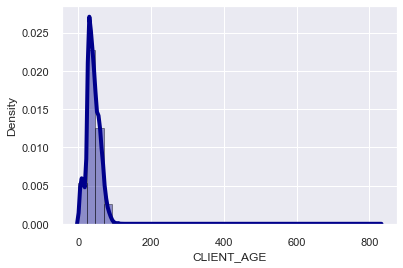

In [24]:
# Histogram and density of clients ages
sns.distplot(data['CLIENT_AGE'], hist=True, kde=True,
             bins=int(180/5), color = 'darkblue',
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4});

--> The feature AGE is Gaussian Distributed


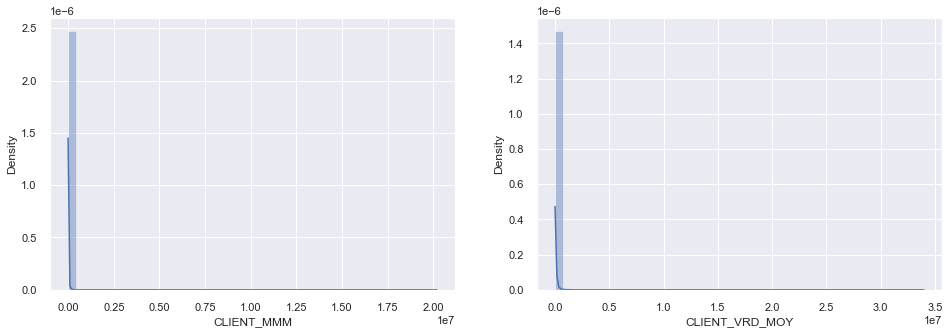

In [25]:
#Plot distributions for the feautures
warnings.filterwarnings('ignore')
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
sns.distplot(data['CLIENT_MMM'])
plt.subplot(1,2,2)
sns.distplot(data['CLIENT_VRD_MOY'])
plt.show()

 MMM and VRD are positively skewed


## Outliers Detection:

In [26]:
data.select_dtypes(include=np.number)

,CLIENT_ID,CLIENT_AGE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_VRD_MOY,VALEUR,TOTAL_PACK
0,178601,51,0.00,27713.798,916.666,1,0,0,0,0,0,0,900.0,0.000000,1,1.0
1,98070,58,0.00,84.396,0.000,0,0,0,0,0,0,0,NaN,0.000000,1,1.0
2,454569,57,3013.95,849.304,1252.316,0,1,1,0,0,0,0,538.0,2933.309050,1,1.0
3,40717,52,0.00,783.062,1748.310,0,3,1,0,0,0,0,NaN,349.795150,1,1.0
4,442731,58,631.94,0.000,216.331,0,0,0,0,0,0,0,NaN,1373.050000,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
834748,907048,39,0.00,0.000,0.000,0,0,0,0,0,0,0,1000.0,68.235600,1,0.0
834749,220819,51,0.00,0.000,0.000,0,1,0,0,1,0,0,2000.0,1036.870605,1,0.0
834750,292399,45,0.00,0.000,0.000,0,0,0,0,0,0,0,1500.0,1724.586350,1,0.0
834751,607524,38,0.00,284.391,0.000,0,1,0,0,0,0,0,1200.0,17.436850,1,0.0


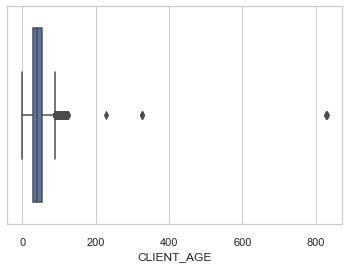

In [27]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x = data["CLIENT_AGE"] ,data = data)

The reasonable range of age is between 18 and 80 years old

In [28]:
#Knowing that the age range should be between 18 and 80, the outliers will be removed
index = data[(data['CLIENT_AGE'] >= 80)|(data['CLIENT_AGE'] <= 18)].index
data.drop(index, inplace=True)
data['CLIENT_AGE'].describe()

count    743740.000000
mean         43.033373
std          14.093584
min          19.000000
25%          31.000000
50%          41.000000
75%          53.000000
max          79.000000
Name: CLIENT_AGE, dtype: float64

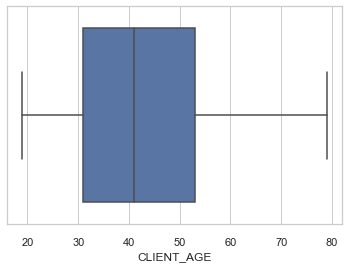

In [29]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x = data["CLIENT_AGE"] ,data = data)

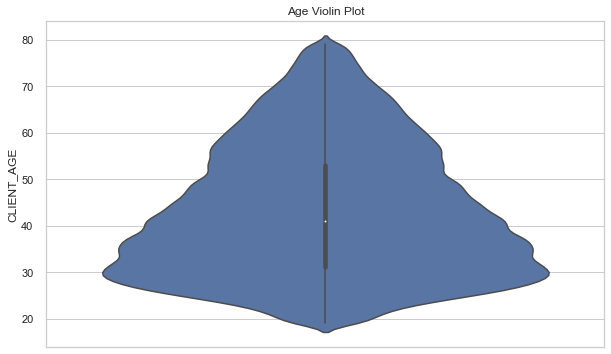

In [30]:
plt.figure(figsize=(10,6))
plt.title("Age Violin Plot")
sns.axes_style("dark")
sns.violinplot(y=data["CLIENT_AGE"])
plt.show()

--> The clients are more frequent at around the age

In [31]:
age_19_25 = data.CLIENT_AGE[(data.CLIENT_AGE >= 18) & (data.CLIENT_AGE <= 25)]
age_26_35 = data.CLIENT_AGE[(data.CLIENT_AGE >= 26) & (data.CLIENT_AGE <= 35)]
age_36_45 = data.CLIENT_AGE[(data.CLIENT_AGE >= 36) & (data.CLIENT_AGE <= 45)]
age_46_55 = data.CLIENT_AGE[(data.CLIENT_AGE >= 46) & (data.CLIENT_AGE <= 55)]
age_55above = data.CLIENT_AGE[data.CLIENT_AGE >= 55]

In [32]:
x_age = ['19-25', '26-35', '36-45', '46-55', '55+']
y_age = [len(age_19_25.values), len(age_26_35.values), len(age_36_45.values), len(age_46_55.values),
     len(age_55above.values)]

px.bar(data_frame = data, x = x_age, y = y_age, color = x_age,
       title = 'Number of customers per age group')

In [33]:
#### If you want to check whether feature is guassian or normal distributed
#### Q-Q plot
def plot_data(df,feature):
    plt.figure(figsize=(10,6))
    plt.subplot(1,2,1)
    df[feature].hist()
    plt.subplot(1,2,2)
    stat.probplot(df[feature],dist='norm',plot=pylab)
    plt.show()

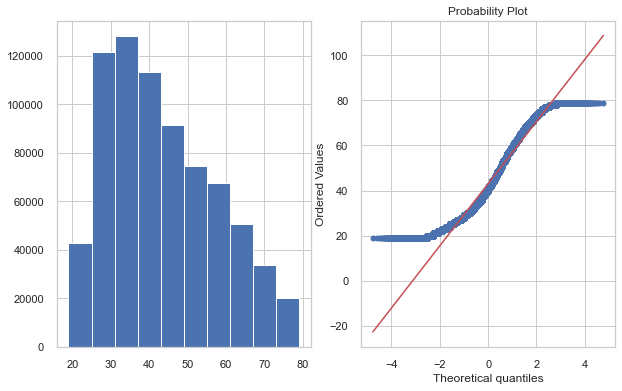

In [34]:
plot_data(data , 'CLIENT_AGE')


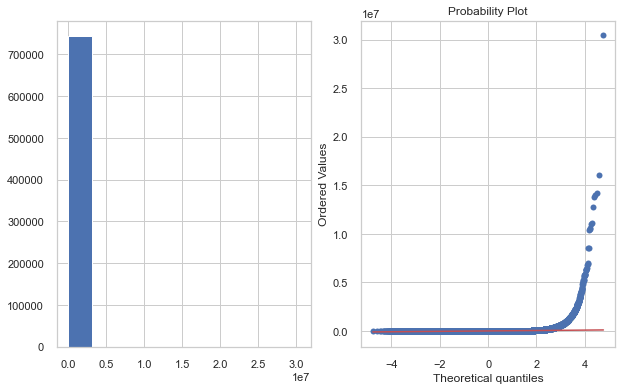

In [35]:
plot_data(data , 'CLIENT_VRD_MOY')

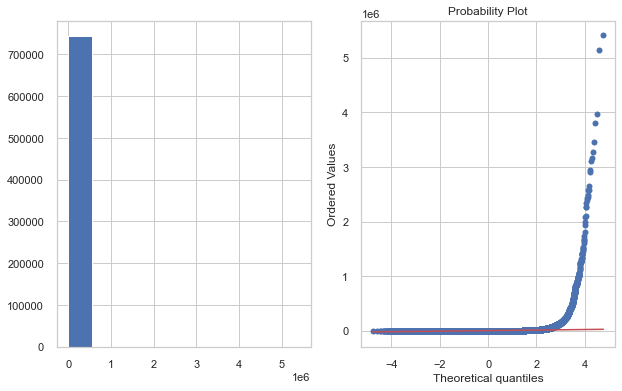

In [36]:
plot_data(data , 'CLIENT_MMM')


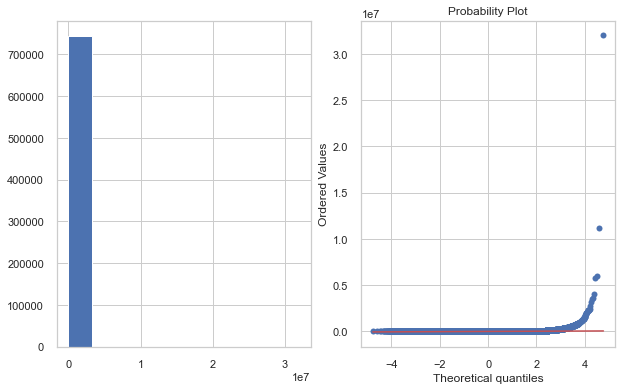

In [37]:
plot_data(data , 'CLIENT_ENCOURS_ENGAGEMENT')


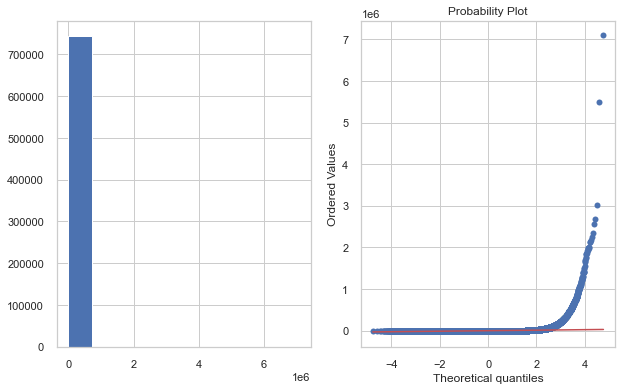

In [38]:
plot_data(data , 'CLIENT_ENCOURS_A_VUE')


### Interquartile Range(IQR)


In [39]:
Q1=data['CLIENT_MMM'].quantile(0.25)
Q3=data['CLIENT_MMM'].quantile(0.75)
IQR=Q3-Q1
IQR

1182.9924999999998

In [40]:
whisker_width = 1.5

MMM_outliers = data[(data['CLIENT_MMM'] < Q1 - whisker_width*IQR) | (data['CLIENT_MMM'] > Q3 + whisker_width*IQR)]
MMM_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
44,1422121,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,36,N_D,0.000,46.238,NON,AUTRE,10034.835,0,0,0,0,0,0,0,Directeurs d'entreprises,1500.0,CLIENT_A_VUE,175.788692,1,True,1.0
72,1310497,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,37,N_D,0.000,340.071,FALSE,AUTRE,5000.000,1,1,0,0,0,0,0,IngÃ©nieurs,1000.0,CLIENT_A_VUE,18005.775150,1,True,1.0
85,1424603,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,37,N_D,0.000,513.562,NON,AUTRE,9619.726,0,2,0,0,0,0,0,Directeurs d'entreprises,2000.0,CLIENT_A_VUE,1335.900909,1,True,1.0
200,534849,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,43,N_D,0.000,24032.169,TRUE,AUTRE,4019.531,1,2,0,0,0,0,0,Cadres moyens dans les autres services,1079.0,CLIENT_A_VUE,785.227950,1,True,1.0
240,1259788,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,32,N_D,132.335,0.000,TRUE,AUTRE,4020.833,1,3,0,0,0,1,0,Cadres moyens dans les autres services,1200.0,CLIENT_A_VUE,22231.286200,1,True,2.0


### Standard Deviation
Standard deviation measures the amount of variation and dispersion of a set of values relative to the average value of the data, it shows the variability distribution of the data.
A high standard deviation indicates that the values are highly dispersed while a low standard deviation indicates that the variation or dispersion of the values is low.

In [41]:
MMM_mean = data['CLIENT_MMM'].mean()
MMM_std = data['CLIENT_MMM'].std()
low= MMM_mean -(3 * MMM_std)
high= MMM_mean + (3 * MMM_std)
MMM_outliers = data[(data['CLIENT_MMM'] < low) | (data['CLIENT_MMM'] > high)]
MMM_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
1508,449416,A1,PART,HAUT DE GAMME,1 ELITE,45,Fabrication de verre plat,257637.717,0.000,TRUE,AUTRE,202853.953,1,2,0,0,0,0,0,Autres cadres supÃ©rieurs,NaN,CLIENT_A_VUE,3.218469e+05,1,True,1.0
1509,321779,A1,PART,HAUT DE GAMME,1 ELITE,68,Intermediaires du commerce en produits divers,13302.227,0.000,NON,AUTRE,121888.027,0,1,1,0,0,1,0,Dirigeants et gÃ©rants dans l'agriculture et l...,30000.0,CLIENT_A_VUE,5.271727e+06,1,True,1.0
1512,456782,A1,PART,HAUT DE GAMME,1 ELITE,51,N_D,0.000,2662.387,NON,AUTRE,104133.225,0,1,0,0,0,0,0,Directeurs d'entreprises,5000.0,CLIENT_A_VUE,1.424540e+04,1,True,1.0
1514,1392898,A1,PART,HAUT DE GAMME,1 ELITE,34,N_D,0.000,6775.978,NON,AUTRE,147203.936,1,1,0,0,0,0,0,Cadres supÃ©rieurs dans l'industrie,15000.0,CLIENT_A_VUE,1.047513e+04,1,True,1.0
1520,311713,A1,PART,HAUT DE GAMME,1 ELITE,76,N_D,9877.691,0.000,NON,AUTRE,117486.507,0,0,0,0,0,0,0,RetraitÃ©s,NaN,CLIENT_A_VUE,7.691548e+05,1,False,0.0


Outliers Treatment
1. Flooring and Capping.
2. Trimming.
3. Replacing outliers with the meanOutliers Treatment

In [42]:
# Flooring and Capping
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
data['CLIENT_MMM']=np.where(data['CLIENT_MMM']>upper_whisker,upper_whisker,np.where(data['CLIENT_MMM']<lower_whisker,lower_whisker,data['CLIENT_MMM']))

<AxesSubplot:xlabel='CLIENT_MMM'>

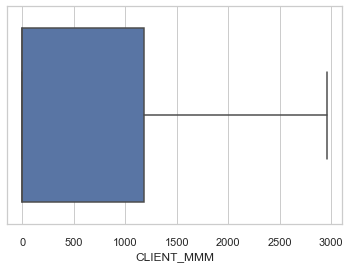

In [43]:
sns.boxplot(data['CLIENT_MMM'],data=data)


In [44]:
MMM_index=data['CLIENT_MMM'][(data['CLIENT_MMM']>upper_whisker)|(data['CLIENT_MMM']<lower_whisker)].index
data.drop(MMM_index,inplace=True)


In [45]:
Q1=data['CLIENT_VRD_MOY'].quantile(0.25)
Q3=data['CLIENT_VRD_MOY'].quantile(0.75)
IQR=Q3-Q1
whisker_width = 1.5

VRD_outliers = data[(data['CLIENT_VRD_MOY'] < Q1 - whisker_width*IQR) | (data['CLIENT_VRD_MOY'] > Q3 + whisker_width*IQR)]
VRD_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
6,98332,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Construction de batiments ( gros oeuvre ),981.287,0.000,NON,AUTRE,1270.15200,0,1,1,0,0,0,0,Cadres moyens dans les autres services,1276.0,CLIENT_A_VUE,49681.30160,1,True,1.0
14,98444,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,39,N_D,0.000,0.000,NON,AUTRE,0.00000,0,0,0,0,0,0,0,Enseignants de l'enseignement secondaire,1800.0,CLIENT_A_VUE,8232.68285,1,False,0.0
25,579536,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,56,N_D,0.000,10.696,NON,AUTRE,50.00000,0,0,0,0,0,0,0,Cadres moyens dans l'industrie,NaN,CLIENT_A_VUE,9774.27215,1,False,0.0
70,1368068,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,42,N_D,0.000,308.781,NON,AUTRE,766.66600,0,1,0,0,0,0,0,Cadres moyens des services administratifs et f...,1000.0,CLIENT_A_VUE,6911.33835,1,True,1.0
72,1310497,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,37,N_D,0.000,340.071,FALSE,AUTRE,2957.48125,1,1,0,0,0,0,0,IngÃ©nieurs,1000.0,CLIENT_A_VUE,18005.77515,1,True,1.0


In [46]:
VRD_mean = data['CLIENT_VRD_MOY'].mean()
VRD_std = data['CLIENT_VRD_MOY'].std()
low= VRD_mean -(3 * VRD_std)
high= VRD_mean + (3 * VRD_std)
VRD_outliers = data[(data['CLIENT_VRD_MOY'] < low) | (data['CLIENT_VRD_MOY'] > high)]
VRD_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
1508,449416,A1,PART,HAUT DE GAMME,1 ELITE,45,Fabrication de verre plat,257637.717,0.0,TRUE,AUTRE,2957.48125,1,2,0,0,0,0,0,Autres cadres supÃ©rieurs,NaN,CLIENT_A_VUE,3.218469e+05,1,True,1.0
1509,321779,A1,PART,HAUT DE GAMME,1 ELITE,68,Intermediaires du commerce en produits divers,13302.227,0.0,NON,AUTRE,2957.48125,0,1,1,0,0,1,0,Dirigeants et gÃ©rants dans l'agriculture et l...,30000.0,CLIENT_A_VUE,5.271727e+06,1,True,1.0
1516,268105,A1,PART,HAUT DE GAMME,1 ELITE,71,N_D,478.688,0.0,NON,AUTRE,2957.48125,0,0,0,0,0,0,3,Directeurs d'entreprises,100.0,CLIENT_A_VUE,2.064617e+06,1,False,0.0
1517,383011,A1,PART,HAUT DE GAMME,1 ELITE,68,N_D,479.649,0.0,NON,AUTRE,2957.48125,0,1,0,0,0,0,2,Sans profession,3000.0,CLIENT_A_VUE,2.144509e+06,1,False,0.0
1518,268104,A1,PART,HAUT DE GAMME,1 ELITE,38,N_D,498.204,0.0,NON,AUTRE,2957.48125,0,1,0,0,0,0,0,Autres cadres supÃ©rieurs,2400.0,CLIENT_A_VUE,1.306355e+06,1,False,0.0


In [47]:
# Flooring and Capping
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
data['CLIENT_VRD_MOY']=np.where(data['CLIENT_VRD_MOY']>upper_whisker,upper_whisker,np.where(data['CLIENT_VRD_MOY']<lower_whisker,lower_whisker,data['CLIENT_VRD_MOY']))

<AxesSubplot:xlabel='CLIENT_VRD_MOY'>

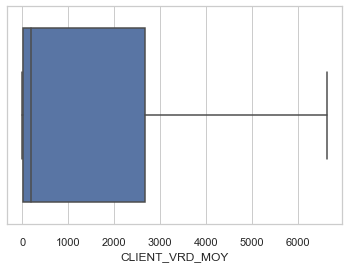

In [48]:
sns.boxplot(data['CLIENT_VRD_MOY'],data=data)


In [49]:
VRD_index=data['CLIENT_VRD_MOY'][(data['CLIENT_VRD_MOY']>upper_whisker)|(data['CLIENT_VRD_MOY']<lower_whisker)].index
data.drop(VRD_index,inplace=True)

In [50]:
Q1=data['CLIENT_ENCOURS_ENGAGEMENT'].quantile(0.25)
Q3=data['CLIENT_ENCOURS_ENGAGEMENT'].quantile(0.75)
IQR=Q3-Q1
whisker_width = 1.5

ENG_outliers = data[(data['CLIENT_ENCOURS_ENGAGEMENT'] < Q1 - whisker_width*IQR) | (data['CLIENT_ENCOURS_ENGAGEMENT'] > Q3 + whisker_width*IQR)]
ENG_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
0,178601,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,51,Activites juridiques,0.000,27713.798,FALSE,AUTRE,916.666,1,0,0,0,0,0,0,Directeurs d'entreprises,900.0,CLIENT_A_VUE,0.00000,1,True,1.0
2,454569,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Coiffure et soins de beaute,3013.950,849.304,NON,AUTRE,1252.316,0,1,1,0,0,0,0,Directeurs d'Ã©tablissements d'enseignement et...,538.0,CLIENT_A_VUE,2933.30905,1,True,1.0
3,40717,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,52,Commerce de detail de tabac,0.000,783.062,NON,AUTRE,1748.310,0,3,1,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,349.79515,1,True,1.0
8,271108,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,60,Hotels avec restaurant,10.015,4597.456,NON,AUTRE,266.666,0,0,0,0,0,0,0,Hauts fonctionnaires de l'administration publique,NaN,CLIENT_A_VUE,168.28845,1,False,0.0
9,385611,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,38,Intermediaires du commerce en produits divers,0.000,5605.453,NON,AUTRE,513.333,0,1,1,0,0,0,0,Hauts fonctionnaires de l'administration publique,NaN,CLIENT_A_VUE,21.42610,1,True,1.0


In [51]:
ENG_mean = data['CLIENT_ENCOURS_ENGAGEMENT'].mean()
ENG_std = data['CLIENT_ENCOURS_ENGAGEMENT'].std()
low= ENG_mean -(3 * ENG_std)
high= ENG_mean + (3 * ENG_std)
ENG_outliers = data[(data['CLIENT_ENCOURS_ENGAGEMENT'] < low) | (data['CLIENT_ENCOURS_ENGAGEMENT'] > high)]
ENG_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
1523,148194,A1,PART,HAUT DE GAMME,1 ELITE,57,Transports maritimes,0.000,219725.659,NON,AUTRE,2957.48125,0,1,0,0,0,0,0,Dirigeants et gÃ©rants dans les services,54000.0,CLIENT_A_VUE,6634.893534,1,True,1.0
1540,339339,A1,PART,HAUT DE GAMME,2 PRESTIGE,54,Commerce d'alimentation generale,51880.057,302056.961,NON,AUTRE,2957.48125,0,0,0,0,0,0,0,Dirigeants et gÃ©rants dans l'industrie,19000.0,CLIENT_A_VUE,6634.893534,1,True,1.0
1623,270462,A1,PART,HAUT DE GAMME,2 PRESTIGE,44,N_D,0.000,168250.822,TRUE,AUTRE,2957.48125,1,2,1,0,1,4,3,Autres cadres supÃ©rieurs,10895.0,CLIENT_A_VUE,6634.893534,1,True,1.0
1624,877522,A1,PART,HAUT DE GAMME,2 PRESTIGE,47,N_D,0.000,190027.579,TRUE,AUTRE,2957.48125,1,3,0,0,0,0,0,Magistrats,5533.0,CLIENT_A_VUE,6634.893534,1,True,2.0
1625,717470,A1,PART,HAUT DE GAMME,2 PRESTIGE,51,N_D,0.000,220323.409,NON,AUTRE,2957.48125,1,1,0,0,0,2,0,Dirigeants et gÃ©rants dans les services,57115.0,CLIENT_A_VUE,6634.893534,1,True,1.0


In [52]:
# Flooring and Capping
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
data['CLIENT_ENCOURS_ENGAGEMENT']=np.where(data['CLIENT_ENCOURS_ENGAGEMENT']>upper_whisker,upper_whisker,np.where(data['CLIENT_ENCOURS_ENGAGEMENT']<lower_whisker,lower_whisker,data['CLIENT_ENCOURS_ENGAGEMENT']))

<AxesSubplot:xlabel='CLIENT_ENCOURS_ENGAGEMENT'>

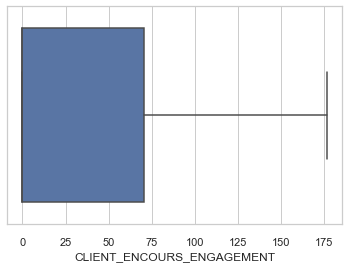

In [53]:
sns.boxplot(data['CLIENT_ENCOURS_ENGAGEMENT'],data=data)


In [54]:
Q1=data['CLIENT_ENCOURS_A_VUE'].quantile(0.25)
Q3=data['CLIENT_ENCOURS_A_VUE'].quantile(0.75)
IQR=Q3-Q1
whisker_width = 1.5

ENG_outliers = data[(data['CLIENT_ENCOURS_A_VUE'] < Q1 - whisker_width*IQR) | (data['CLIENT_ENCOURS_A_VUE'] > Q3 + whisker_width*IQR)]
ENG_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
2,454569,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Coiffure et soins de beaute,3013.950,176.48125,NON,AUTRE,1252.316,0,1,1,0,0,0,0,Directeurs d'Ã©tablissements d'enseignement et...,538.0,CLIENT_A_VUE,2933.309050,1,True,1.0
4,442731,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,58,Commerce de gros d'equipements pour la constru...,631.940,0.00000,NON,AUTRE,216.331,0,0,0,0,0,0,0,Magistrats,NaN,CLIENT_A_VUE,1373.050000,1,False,0.0
5,270519,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,70,Commerce de gros d'habillement,4025.130,0.00000,FALSE,AUTRE,250.000,1,1,1,0,0,0,0,RetraitÃ©s,1600.0,CLIENT_A_VUE,5309.596200,1,False,0.0
6,98332,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,57,Construction de batiments ( gros oeuvre ),981.287,0.00000,NON,AUTRE,1270.152,0,1,1,0,0,0,0,Cadres moyens dans les autres services,1276.0,CLIENT_A_VUE,6634.893534,1,True,1.0
8,271108,A1,PART,CLASSE MOYENNE,1 CM - SALARIÉ,60,Hotels avec restaurant,10.015,176.48125,NON,AUTRE,266.666,0,0,0,0,0,0,0,Hauts fonctionnaires de l'administration publique,NaN,CLIENT_A_VUE,168.288450,1,False,0.0


In [55]:
AV_mean = data['CLIENT_ENCOURS_A_VUE'].mean()
AV_std = data['CLIENT_ENCOURS_A_VUE'].std()
low= AV_mean -(3 * AV_std)
high= AV_mean + (3 * AV_std)
ENG_outliers = data[(data['CLIENT_ENCOURS_A_VUE'] < low) | (data['CLIENT_ENCOURS_A_VUE'] > high)]
ENG_outliers.head()

,CLIENT_ID,AGENCE,MARCHE,SEGMENT,SOUS SEGMENT,CLIENT_AGE,CLIENT_ACTIVITE,CLIENT_ENCOURS_A_VUE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_ENROLES,CLIENT_ENTREE_FINAL,CLIENT_MMM,CLIENT_NOMBRE_BIATNET,CLIENT_NOMBRE_CARTES,CLIENT_NOMBRE_MESSAGIS,CLIENT_NOMBRE_FAMILIA,CLIENT_NOMBRE_OPCVM,CLIENT_NOMBRE_PROJET_AVENIR,CLIENT_NOMBRE_TITRES,CLIENT_PROFESSION,CLIENT_REVENUS_MENSUELS_NETS,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,VALEUR,PACK,TOTAL_PACK
1508,449416,A1,PART,HAUT DE GAMME,1 ELITE,45,Fabrication de verre plat,257637.717,0.00000,TRUE,AUTRE,2957.48125,1,2,0,0,0,0,0,Autres cadres supÃ©rieurs,NaN,CLIENT_A_VUE,6634.893534,1,True,1.0
1537,328325,A1,PART,HAUT DE GAMME,2 PRESTIGE,49,Autres services personnels,121221.556,176.48125,NON,AUTRE,2957.48125,0,0,1,0,0,2,0,Hauts fonctionnaires de l'administration publique,14000.000,CLIENT_A_VUE,6634.893534,1,True,1.0
1543,385603,A1,PART,HAUT DE GAMME,2 PRESTIGE,64,Commerce de gros de biens de consommation non ...,151442.243,0.00000,TRUE,AUTRE,895.99600,1,2,0,0,0,0,0,Hauts fonctionnaires de l'administration publique,NaN,CLIENT_A_VUE,6634.893534,1,True,1.0
1545,442896,A1,PART,HAUT DE GAMME,2 PRESTIGE,47,Commerces de detail divers en magasin specialise,303863.881,176.48125,FALSE,AUTRE,2957.48125,1,2,0,0,0,1,6,Dirigeants et gÃ©rants dans les services,3967.378,CLIENT_A_VUE,6634.893534,1,True,1.0
1761,270593,A1,PART,HAUT DE GAMME,2 PRESTIGE,58,N_D,81522.380,0.00000,TRUE,AUTRE,2957.48125,1,1,0,0,0,0,0,Autres cadres supÃ©rieurs,2900.000,CLIENT_A_VUE,6634.893534,1,True,1.0


In [56]:
# Flooring and Capping
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
data['CLIENT_ENCOURS_A_VUE']=np.where(data['CLIENT_ENCOURS_A_VUE']>upper_whisker,upper_whisker,np.where(data['CLIENT_ENCOURS_A_VUE']<lower_whisker,lower_whisker,data['CLIENT_ENCOURS_A_VUE']))

<AxesSubplot:xlabel='CLIENT_ENCOURS_A_VUE'>

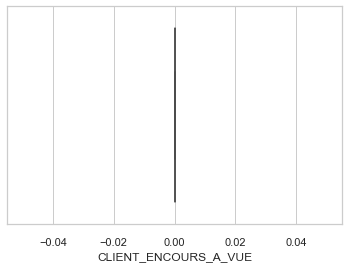

In [57]:
sns.boxplot(data['CLIENT_ENCOURS_A_VUE'],data=data)


In [58]:
data['CLIENT_NOMBRE_CARTES'].unique()

array([ 0,  1,  3,  2,  4,  5,  7,  6,  8, 12,  9, 10, 72])

In [59]:
index = data[(data['CLIENT_NOMBRE_CARTES'] > 5)].index
data.drop(index, inplace=True)
data['CLIENT_NOMBRE_CARTES'].describe()

count    743339.000000
mean          0.878349
std           1.019329
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           5.000000
Name: CLIENT_NOMBRE_CARTES, dtype: float64

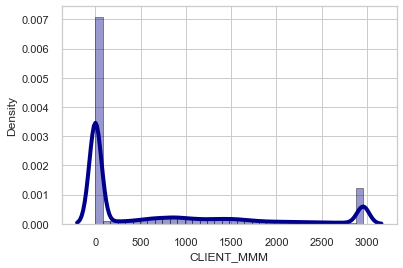

In [60]:
# Histogram and density of clients MMMs
sns.distplot(data['CLIENT_MMM'], hist=True, kde=True,
             bins=int(180/5), color = 'darkblue',
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4});

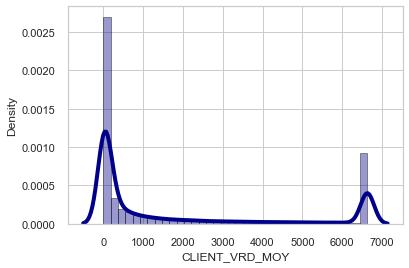

In [61]:
# Histogram and density of clients VRDs
sns.distplot(data['CLIENT_VRD_MOY'], hist=True, kde=True,
             bins=int(180/5), color = 'darkblue',
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4});

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 [Text(0, 0, '19'),
  Text(1, 0, '20'),
  Text(2, 0, '21'),
  Text(3, 0, '22'),
  Text(4, 0, '23'),
  Text(5, 0, '24'),
  Text(6, 0, '25'),
  Text(7, 0, '26'),
  Text(8, 0, '27'),
  Text(9, 0, '28'),
  Text(10, 0, '29'),
  Text(11, 0, '30'),
  Text(12, 0, '31'),
  Text(13, 0, '32'),
  Text(14, 0, '33'),
  Text(15, 0, '34'),
  Text(16, 0, '35'),
  Text(17, 0, '36'),
  Text(18, 0, '37'),
  Text(19, 0, '38'),
  Text(20, 0, '39'),
  Text(21, 0, '40'),
  Text(22, 0, '41'),
  Text(23, 0, '42'),
  Text(24, 0, '43'),
  Text(25, 0, '44'),
  Text(26, 0, '45'),
  Text(27, 0, '46'),
  Text(28, 0, '47'),
  Text(29, 0, '48'),
  Text(30, 0, '49'),
  Text(31, 0, '50'),
  Text(32, 0, '51'),
  Text(33, 0, '52'),
  Text(34, 0, '53'

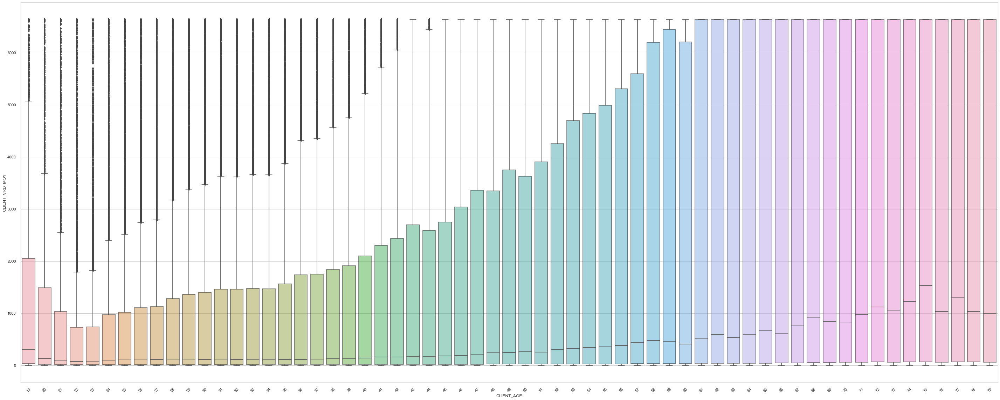

In [62]:
plt.figure(figsize = (50, 20))
ax = sns.boxplot(x = data['CLIENT_AGE'], y = data['CLIENT_VRD_MOY'], data= data)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 [Text(0, 0, '19'),
  Text(1, 0, '20'),
  Text(2, 0, '21'),
  Text(3, 0, '22'),
  Text(4, 0, '23'),
  Text(5, 0, '24'),
  Text(6, 0, '25'),
  Text(7, 0, '26'),
  Text(8, 0, '27'),
  Text(9, 0, '28'),
  Text(10, 0, '29'),
  Text(11, 0, '30'),
  Text(12, 0, '31'),
  Text(13, 0, '32'),
  Text(14, 0, '33'),
  Text(15, 0, '34'),
  Text(16, 0, '35'),
  Text(17, 0, '36'),
  Text(18, 0, '37'),
  Text(19, 0, '38'),
  Text(20, 0, '39'),
  Text(21, 0, '40'),
  Text(22, 0, '41'),
  Text(23, 0, '42'),
  Text(24, 0, '43'),
  Text(25, 0, '44'),
  Text(26, 0, '45'),
  Text(27, 0, '46'),
  Text(28, 0, '47'),
  Text(29, 0, '48'),
  Text(30, 0, '49'),
  Text(31, 0, '50'),
  Text(32, 0, '51'),
  Text(33, 0, '52'),
  Text(34, 0, '53'

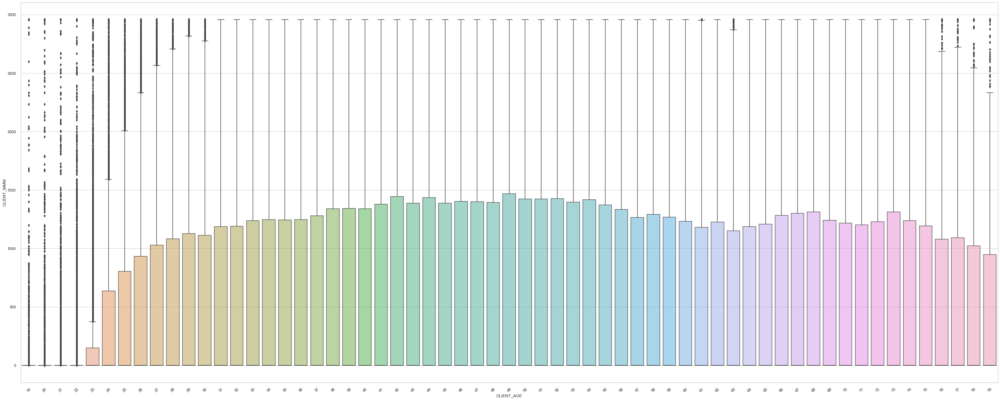

In [63]:
plt.figure(figsize = (50, 20))
ax = sns.boxplot(x = data['CLIENT_AGE'], y = data['CLIENT_MMM'], data= data)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

Text(0.5, 1.0, 'MMM by AGE')

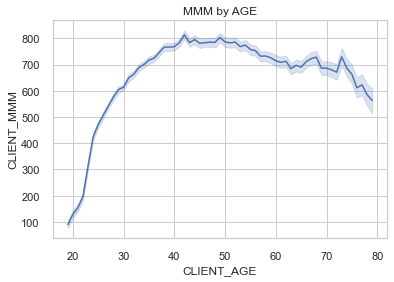

In [64]:
fig,ax = plt.subplots()
ax = sns.lineplot(data = data,  x="CLIENT_AGE", y="CLIENT_MMM")
ax.set_title("MMM by AGE")

Text(0.5, 1.0, 'VRD by AGE')

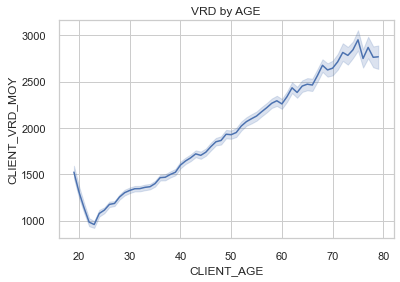

In [65]:
fig,ax = plt.subplots()
ax = sns.lineplot(data = data,  x="CLIENT_AGE", y="CLIENT_VRD_MOY")
ax.set_title("VRD by AGE")

Text(0.5, 1.0, 'ENGAGEMENT by AGE')

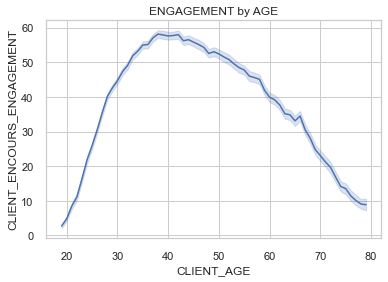

In [66]:
fig,ax = plt.subplots()
ax = sns.lineplot(data = data,  x="CLIENT_AGE", y="CLIENT_ENCOURS_ENGAGEMENT")
ax.set_title("ENGAGEMENT by AGE")

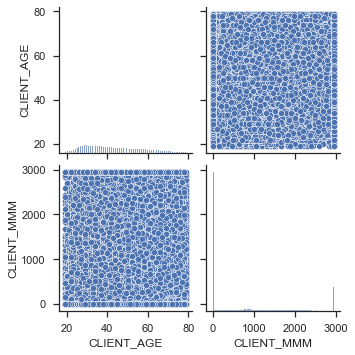

In [67]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(data , vars=["CLIENT_AGE", "CLIENT_MMM"])
plt.show()

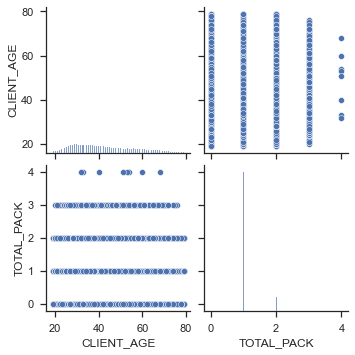

In [68]:
sns.set(style="ticks", color_codes=True)
gg = sns.pairplot(data , vars=["CLIENT_AGE", "TOTAL_PACK"])
plt.show()

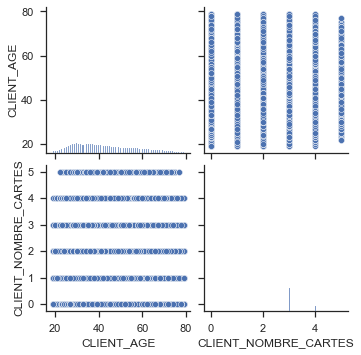

In [69]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(data , vars=["CLIENT_AGE", "CLIENT_NOMBRE_CARTES"])
plt.show()

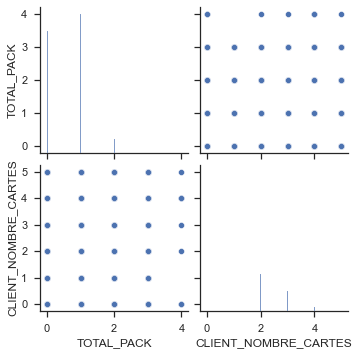

In [70]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(data , vars=["TOTAL_PACK", "CLIENT_NOMBRE_CARTES"])
plt.show()

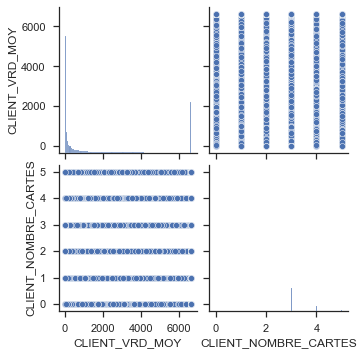

In [71]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(data , vars=["CLIENT_VRD_MOY", "CLIENT_NOMBRE_CARTES"])
plt.show()

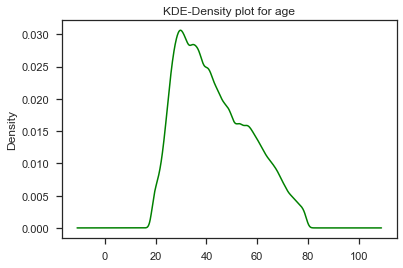

In [72]:
data.CLIENT_AGE.plot.kde(color='green')
plt.title('KDE-Density plot for age')
plt.show()

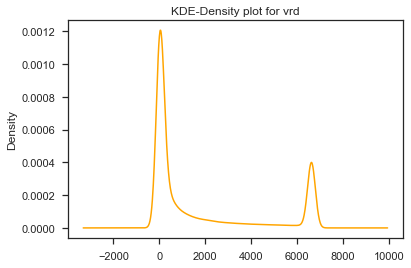

In [73]:
data.CLIENT_VRD_MOY.plot.kde(color='orange')
plt.title('KDE-Density plot for vrd')
plt.show()

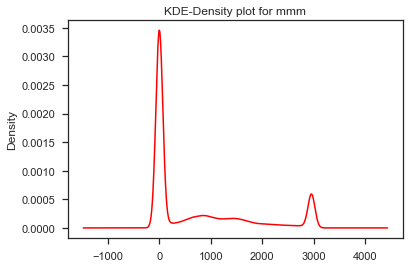

In [74]:
data.CLIENT_MMM.plot.kde(color='red')
plt.title('KDE-Density plot for mmm')
plt.show()

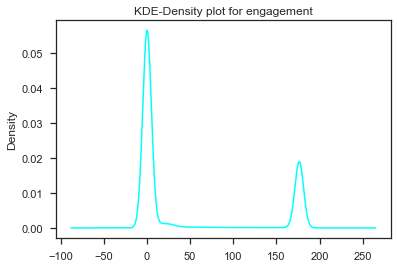

In [75]:
data.CLIENT_ENCOURS_ENGAGEMENT.plot.kde(color='cyan')
plt.title('KDE-Density plot for engagement')
plt.show()

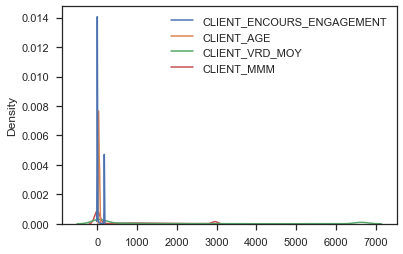

In [76]:
columns = data[['CLIENT_ENCOURS_ENGAGEMENT','CLIENT_AGE','CLIENT_VRD_MOY','CLIENT_MMM']]
data_density = columns.copy()
data_density
sns.kdeplot(data=data_density)
plt.show()

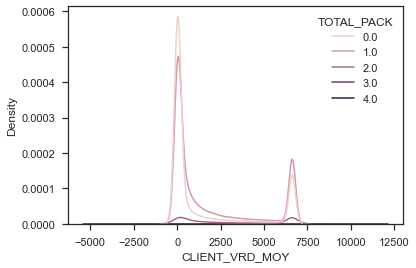

In [77]:
sns.kdeplot(data=data,x="CLIENT_VRD_MOY",hue='TOTAL_PACK')
plt.show()

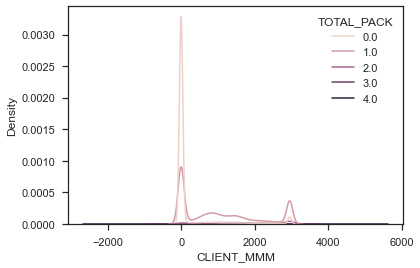

In [78]:
sns.kdeplot(data=data,x="CLIENT_MMM",hue='TOTAL_PACK')
plt.show()

## Categorical data 

In [79]:
data['CLIENT_ENROLES'].unique()

array(['FALSE', 'NON', 'TRUE'], dtype=object)

In [80]:
data['CLIENT_ENROLES'].replace('NON','FALSE',inplace=True)


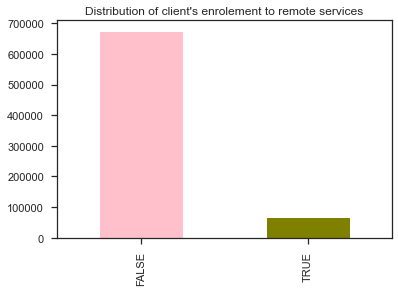

In [81]:
data.CLIENT_ENROLES.value_counts().plot(kind="bar" , color=['pink','olive'])
plt.title("Distribution of client's enrolement to remote services")
plt.show()

--> Most of the clients are not enrolled to the remote services 

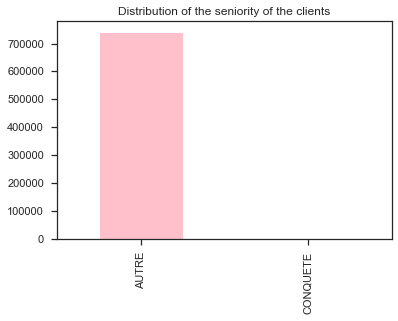

In [82]:
#Client's seniority

data.CLIENT_ENTREE_FINAL.value_counts().plot(kind="bar" , color=['pink','olive'])
plt.title("Distribution of the seniority of the clients")
plt.show()

In [83]:
len(data[data['CLIENT_ENTREE_FINAL']=='CONQUETE'])


604

In [84]:
len(data[data['CLIENT_ENTREE_FINAL']=='AUTRE'])


742735

In [85]:
data['CLIENT_PROFESSION'].unique()


array(["Directeurs d'entreprises",
       "Directeurs d'Ã©tablissements d'enseignement et de formation, et assimilÃ©s",
       'Magistrats', 'RetraitÃ©s',
       'Cadres moyens dans les autres services',
       "Hauts fonctionnaires de l'administration publique",
       "Enseignants de l'enseignement primaire",
       "Enseignants de l'enseignement secondaire", 'Sans profession',
       'MÃ©decins de la fonction publique et assimilÃ©s',
       'Autres cadres supÃ©rieurs',
       "Membres de l'exÃ©cutif et du corps lÃ©gislatif",
       "Cadres moyens dans l'administration publique",
       'Conducteurs dans le transport de marchandises',
       'Techniciens (autres)', "Cadres moyens dans l'industrie",
       'EmployÃ©s de bureau',
       'Techniciens en batiment et travaux publics',
       'Cadres moyens des services administratifs et financiers',
       'Enseignants universitaires', 'Ouvriers dans autres secteurs',
       "Ouvriers dans l'industrie",
       'SecrÃ©taires, opÃ©rateurs d

In [86]:
data['CLIENT_ACTIVITE'].unique()

array(['Activites juridiques', 'Autres activites manufacturieres n.c.a.',
       'Coiffure et soins de beaute', 'Commerce de detail de tabac',
       "Commerce de gros d'equipements pour la construction",
       "Commerce de gros d'habillement",
       'Construction de batiments ( gros oeuvre )',
       'Hotels avec restaurant',
       'Intermediaires du commerce en produits divers', 'N_D',
       'Pratique medicale', 'Services domestiques',
       'Transports maritimes',
       'Autres commerces de detail en magasin non specialise sans predominance alimentaire',
       'Commerce de detail de livres, journaux et papeterie',
       'Fabrication de vetements de dessous', "Activites d'architecture",
       "Activites comptables et d'audit, conseil fiscal",
       'Autres intermediaires specialises du commerce',
       'Autres services personnels', 'Commerce de gros de textiles',
       'Culture de legumes, maraichage',
       'Fabrication de plaques, feuilles, tubes et profiles en matiere

In [87]:
data=data.drop(columns = ['CLIENT_ACTIVITE'])


<AxesSubplot:>

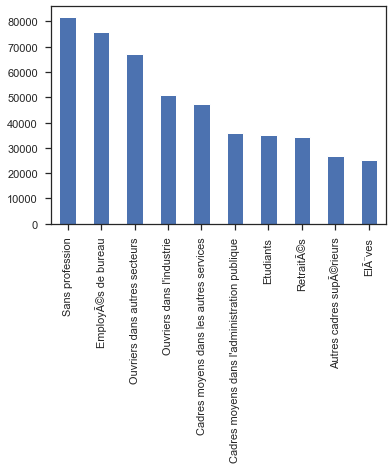

In [88]:
data.CLIENT_PROFESSION.value_counts()[:10].plot(kind='bar')


The majority of the clients do not have a job
Also the professions will be categorized and corrected.

In [89]:
#Cadre sup
data['CLIENT_PROFESSION'].replace("Autres cadres supÃ©rieurs", "Cadre supérieur", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres supÃ©rieurs des services administratifs et financiers", "Cadre supérieur", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres supÃ©rieurs dans l'industrie", "Cadre supérieur", inplace=True)
data['CLIENT_PROFESSION'].replace("Hauts fonctionnaires de l'administration publique", "Cadre supérieur", inplace=True)
data['CLIENT_PROFESSION'].replace("Chefs de mission diplomatique et assimilÃ©s", "Cadre supérieur", inplace=True)
#Cadre moy
data['CLIENT_PROFESSION'].replace("Cadres moyens dans les autres services", "Cadre moyen", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres moyens dans l'administration publique", "Cadre moyen", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres moyens dans l'industrie", "Cadre moyen", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres moyens des services administratifs et financiers", "Cadre moyen", inplace=True)
data['CLIENT_PROFESSION'].replace("Cadres moyens dans l'administration publique", "Cadre moyen", inplace=True)

#Justice

data['CLIENT_PROFESSION'].replace("Huissiers de justice, notaires, experts judiciaires et assimilÃ©s", "Acteur de la justice", inplace=True)
data['CLIENT_PROFESSION'].replace("Membres de l'exÃ©cutif et du corps lÃ©gislatif", "Acteur de la justice", inplace=True)
data['CLIENT_PROFESSION'].replace("Magistrats", "Acteur de la justice", inplace=True)
data['CLIENT_PROFESSION'].replace("Avocats", "Acteur de la justice", inplace=True)

#Employés de bureau

data['CLIENT_PROFESSION'].replace("EmployÃ©s de bureau", "Employés de bureau", inplace=True)
data['CLIENT_PROFESSION'].replace("SecrÃ©taires, opÃ©rateurs de traitement de texte et assimilÃ©s", "Employé de bureau", inplace=True)

#Retraités
data['CLIENT_PROFESSION'].replace("RetraitÃ©s", "Retraités", inplace=True)



#Santé
data['CLIENT_PROFESSION'].replace("MÃ©decins de la fonction publique et assimilÃ©s", "Professionnel en santé", inplace=True)
data['CLIENT_PROFESSION'].replace("MÃ©decins gÃ©nÃ©ralistes", "Professionnel en santé", inplace=True)
data['CLIENT_PROFESSION'].replace("MÃ©decins spÃ©cialistes", "Professionnel en santé", inplace=True)

data['CLIENT_PROFESSION'].replace("MÃ©decins dentistes", "Professionnel en santé", inplace=True)
data['CLIENT_PROFESSION'].replace("MÃ©decins vÃ©tÃ©rinaires", "Professionnel en santé", inplace=True)

data['CLIENT_PROFESSION'].replace("Pharmaciens", "Professionnel en santé ", inplace=True)

data['CLIENT_PROFESSION'].replace("MÃ©decins", "Professionnel en santé ", inplace=True)

# para
data['CLIENT_PROFESSION'].replace("Opticiens-lunetiers", "Professionnel en para-médicales", inplace=True)
data['CLIENT_PROFESSION'].replace("Professions para-mÃ©dicales", "Professionnel en para-médicales", inplace=True)


#Dirigeant
data['CLIENT_PROFESSION'].replace("Dirigeants et gÃ©rants dans l'industrie", "Dirigeant et gérant ", inplace=True)
data['CLIENT_PROFESSION'].replace("Dirigeants et gÃ©rants dans le tourisme, la restauration et l'hotellerie", "Dirigeant et gérant", inplace=True)

data['CLIENT_PROFESSION'].replace("Dirigeants et gÃ©rants dans le transport", "Dirigeant et gérant", inplace=True)

data['CLIENT_PROFESSION'].replace("Dirigeants et gÃ©rants dans l'agriculture et la pÃªche", "Dirigeant et gérant", inplace=True)
data['CLIENT_PROFESSION'].replace("Dirigeants et gÃ©rants dans les services", "Dirigeant et gérant", inplace=True)

#Ingénieur
data['CLIENT_PROFESSION'].replace("IngÃ©nieurs", "Ingénieurs", inplace=True)

#Technicien
data['CLIENT_PROFESSION'].replace("Techniciens (autres)", "Technicien", inplace=True)
data['CLIENT_PROFESSION'].replace("Techniciens en batiment et travaux publics", "Technicien", inplace=True)
data['CLIENT_PROFESSION'].replace("Techniciens en informatique et nouvelles technologies", "Technicien", inplace=True)
data['CLIENT_PROFESSION'].replace("Techniciens de laboratoire", "Technicien", inplace=True)


#Ouvrier
data['CLIENT_PROFESSION'].replace("Ouvriers des mÃ©tiers d'artisanat", "Ouvrier", inplace=True)
data['CLIENT_PROFESSION'].replace("Ouvriers dans autres secteurs", "Ouvrier", inplace=True)
data['CLIENT_PROFESSION'].replace("Ouvriers dans l'industrie", "Ouvrier", inplace=True)
data['CLIENT_PROFESSION'].replace("Ouvriers agricoles", "Ouvrier", inplace=True)

#Scientifique
data['CLIENT_PROFESSION'].replace("SpÃ©cialistes scientifiques", "Spécialiste scientifique", inplace=True)
data['CLIENT_PROFESSION'].replace("Biologistes et assimilÃ©s", "Spécialiste scientifique", inplace=True)
#Prestataire de services
data['CLIENT_PROFESSION'].replace("Coiffeurs, esthÃ©ticiens et assimilÃ©s", "Prestataire de services", inplace=True)
data['CLIENT_PROFESSION'].replace("Courtiers", "Prestataire de services", inplace=True)
data['CLIENT_PROFESSION'].replace("Autres prestataires de service", "Prestataire de services", inplace=True)

#Acteur en bâtiment travaux publics
data['CLIENT_PROFESSION'].replace("MaÃ§ons et assimilÃ©s", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("Electriciens", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("MÃ©caniciens", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("Conducteurs dans le batiment et travaux publics", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("Plombiers", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("Architectes et urbanistes", "Acteur en bâtiment travaux publics", inplace=True)
data['CLIENT_PROFESSION'].replace("Menuisiers", "Acteur en bâtiment travaux publics", inplace=True)

#Consultant
data['CLIENT_PROFESSION'].replace("Conseillers et consultants", "Conseiller et consultant", inplace=True)
data['CLIENT_PROFESSION'].replace("Experts-comptables", "Conseiller et consultant", inplace=True)

#Service défense sécurité
data['CLIENT_PROFESSION'].replace("Forces ArmÃ©es", "Acteur en service de défense/sécurité", inplace=True)


data['CLIENT_PROFESSION'].replace("Agents de la force publique", "Acteur en service de défense/sécurité", inplace=True)
data['CLIENT_PROFESSION'].replace("Pilotes et officiers de pont", "Acteur en service de défense/sécurité", inplace=True)

#Artisan
data['CLIENT_PROFESSION'].replace("Artisans dans la restauration, l'alimentation et assimilÃ©s", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans du batiment et assimilÃ©s", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans du textile, de l'habillement et assimilÃ©s", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans dans l'imprimerie et assimilÃ©s", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans du bois et assimilÃ©s", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans du cuir et de la chaussure", "Artisan", inplace=True)
data['CLIENT_PROFESSION'].replace("Artisans (autres)", "Artisan", inplace=True)

#Commerçant
data['CLIENT_PROFESSION'].replace("CommerÃ§ants (autres)", "Commerçant", inplace=True)
data['CLIENT_PROFESSION'].replace("CommerÃ§ants dans l'alimentation gÃ©nÃ©rale", "Commerçant", inplace=True)
data['CLIENT_PROFESSION'].replace("CommerÃ§ants dans l'entretien et rÃ©paration", "Commerçant", inplace=True)
data['CLIENT_PROFESSION'].replace("CommerÃ§ants dans l'habillement et la chaussure", "Commerçant", inplace=True)

data['CLIENT_PROFESSION'].replace("CommerÃ§ants dans le tourisme, loisirs et restauration", "Commerçant", inplace=True)
data['CLIENT_PROFESSION'].replace("CommerÃ§ants dans l'ameublement, appareils Ã©lectro mÃ©nager et assimilÃ©s", "Commerçant", inplace=True)



#Education
data['CLIENT_PROFESSION'].replace("Inspecteur pÃ©dagogique", "Acteur dans le secteur d'éducation", inplace=True)
data['CLIENT_PROFESSION'].replace("Directeurs d'Ã©tablissements d'enseignement et de formation, et assimilÃ©s", "Acteur dans le secteur d'éducation", inplace=True)
data['CLIENT_PROFESSION'].replace("Enseignants de l'enseignement primaire", "Acteur dans le secteur d'éducation", inplace=True)
data['CLIENT_PROFESSION'].replace("Enseignants universitaires", "Acteur dans le secteur d'éducation", inplace=True)
data['CLIENT_PROFESSION'].replace("Enseignants de l'enseignement secondaire", "Acteur dans le secteur d'éducation", inplace=True)

#Agriculture
data['CLIENT_PROFESSION'].replace("PÃªcheurs", "Agriculteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Eleveurs", "Agriculteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Agriculteurs", "Agriculteur", inplace=True)

#Conducteurs
data['CLIENT_PROFESSION'].replace("Conducteurs dans le transport de marchandises", "Conducteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Chauffeurs de taxis et conducteurs d'automobiles et de camionnettes", "Conducteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Conducteurs d'engins agricoles", "Conducteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Conducteurs dans le transport public", "Conducteur", inplace=True)
data['CLIENT_PROFESSION'].replace("Conducteurs d'engins agricoles", "Conducteur", inplace=True)

data['CLIENT_PROFESSION'].replace("Etudiants", "Étudiants", inplace=True)
data['CLIENT_PROFESSION'].replace("Sportifs et assimilÃ©s", "Sportifs et assimilés", inplace=True)



#Agent

data['CLIENT_PROFESSION'].replace("Agents d'accueil, de sÃ©curitÃ© et de nettoyage", "Agent", inplace=True)
data['CLIENT_PROFESSION'].replace("Agents", "Agent", inplace=True)
data['CLIENT_PROFESSION'].replace("Transitaires et commissionnaires", "Agent", inplace=True)

data['CLIENT_PROFESSION'].replace("ElÃ¨ves", "Élèves", inplace=True)




In [90]:
data['CLIENT_PROFESSION'].unique()

array(["Directeurs d'entreprises", "Acteur dans le secteur d'éducation",
       'Acteur de la justice', 'Retraités', 'Cadre moyen',
       'Cadre supérieur', 'Sans profession', 'Professionnel en santé',
       'Conducteur', 'Technicien', 'Employés de bureau', 'Ouvrier',
       'Employé de bureau', 'Dirigeant et gérant ', 'Ingénieurs',
       'Élèves', 'Acteur en service de défense/sécurité',
       'Dirigeant et gérant', 'Artistes', 'Agent',
       'Acteur en bâtiment travaux publics', 'Agriculteur', 'Coursiers',
       'Artisan', 'Étudiants', 'Sportifs et assimilés',
       'Spécialiste scientifique', 'Commerçant',
       'Prestataire de services', 'Professionnel en santé ',
       'Professionnel en para-médicales', 'Conseiller et consultant',
       'N_D'], dtype=object)

In [91]:
# Replace the "unknow" Category with the Mode value
data.CLIENT_PROFESSION.replace("N_D",data.CLIENT_PROFESSION.mode() [0],inplace=True)

In [92]:
#create a fuction to explore the categorical variables

def plot(attribute_category):
    attribute_category.value_counts().plot(kind="bar")
    plt.title("attribute distribution")
    plt.show()
    print("\n")

    pd.crosstab(attribute_category,data.SEGMENT).T.plot(kind="bar",stacked = True)
    plt.legend(bbox_to_anchor=(1.0, 0.5))
    plt.title("The ratio of  attribute category to y category (yes/no)")
    plt.show()
    print("[Each column sums up to 1] ")
    print (pd.crosstab(attribute_category,data.SEGMENT,normalize="columns"))
    print("\n\n\n")

    pd.crosstab(attribute_category,data.SEGMENT).plot(kind="bar",stacked = True)
    plt.title("The ratio of y category (yes/no) to attribute category")
    plt.show()
    print("[Each row sums up to 1]")
    print (pd.crosstab(attribute_category,data.SEGMENT,normalize="index"))

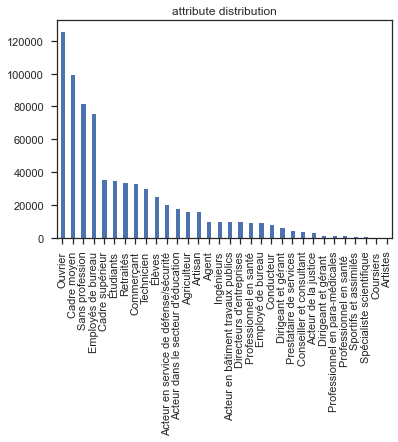

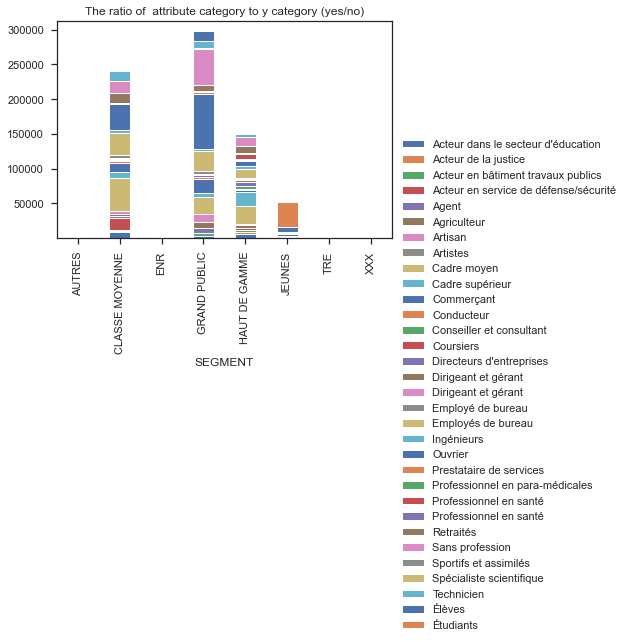

[Each column sums up to 1] 
SEGMENT                                AUTRES  CLASSE MOYENNE  ENR  \
CLIENT_PROFESSION                                                    
Acteur dans le secteur d'éducation        0.0        0.039992  0.0   
Acteur de la justice                      0.0        0.000466  0.0   
Acteur en bâtiment travaux publics        0.0        0.010566  0.0   
Acteur en service de défense/sécurité     0.0        0.066185  0.0   
Agent                                     0.0        0.012255  0.0   
Agriculteur                               0.0        0.012717  0.0   
Artisan                                   0.5        0.017398  0.0   
Artistes                                  0.0        0.000586  0.0   
Cadre moyen                               0.0        0.197060  0.5   
Cadre supérieur                           0.0        0.038229  0.5   
Commerçant                                0.5        0.049035  0.0   
Conducteur                                0.0        0.013344 

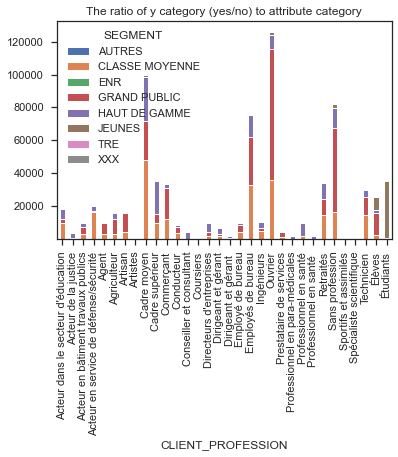

[Each row sums up to 1]
SEGMENT                                  AUTRES  CLASSE MOYENNE       ENR  \
CLIENT_PROFESSION                                                           
Acteur dans le secteur d'éducation     0.000000        0.530004  0.000000   
Acteur de la justice                   0.000000        0.031831  0.000000   
Acteur en bâtiment travaux publics     0.000000        0.257727  0.000000   
Acteur en service de défense/sécurité  0.000000        0.781699  0.000000   
Agent                                  0.000000        0.283708  0.000000   
Agriculteur                            0.000000        0.191724  0.000000   
Artisan                                0.000062        0.262486  0.000000   
Artistes                               0.000000        0.285141  0.000000   
Cadre moyen                            0.000000        0.478603  0.000010   
Cadre supérieur                        0.000000        0.259614  0.000028   
Commerçant                             0.000030     

In [93]:
plot(data.CLIENT_PROFESSION)

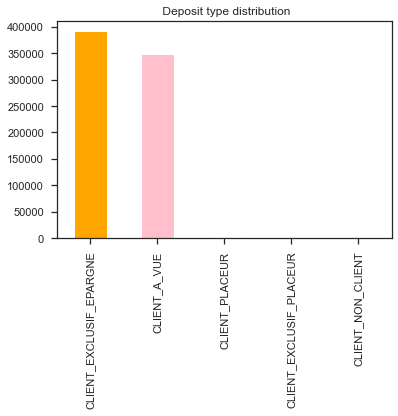

In [94]:
data.CLIENT_TYPE_DEPOSANT.value_counts().plot(kind="bar" , color=['orange', 'pink', 'cyan', 'olive'])
plt.title(" Deposit type distribution")
plt.show()

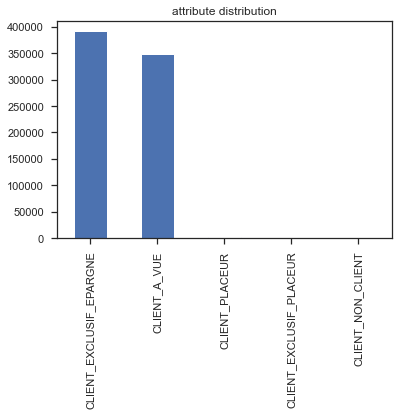

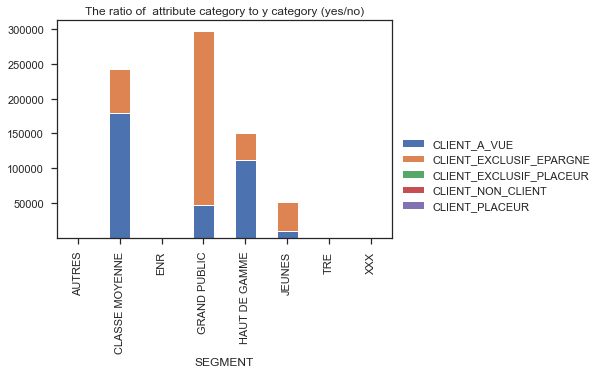

[Each column sums up to 1] 
SEGMENT                  AUTRES  CLASSE MOYENNE  ENR  GRAND PUBLIC  \
CLIENT_TYPE_DEPOSANT                                                 
CLIENT_A_VUE                0.5        0.738711  1.0      0.159418   
CLIENT_EXCLUSIF_EPARGNE     0.5        0.259939  0.0      0.839961   
CLIENT_EXCLUSIF_PLACEUR     0.0        0.000078  0.0      0.000000   
CLIENT_NON_CLIENT           0.0        0.000000  0.0      0.000003   
CLIENT_PLACEUR              0.0        0.001271  0.0      0.000618   

SEGMENT                  HAUT DE GAMME    JEUNES       TRE       XXX  
CLIENT_TYPE_DEPOSANT                                                  
CLIENT_A_VUE                  0.738420  0.198813  0.647059  0.847222  
CLIENT_EXCLUSIF_EPARGNE       0.250815  0.798444  0.352941  0.152778  
CLIENT_EXCLUSIF_PLACEUR       0.000388  0.000117  0.000000  0.000000  
CLIENT_NON_CLIENT             0.000000  0.000000  0.000000  0.000000  
CLIENT_PLACEUR                0.010377  0.002626  0.000

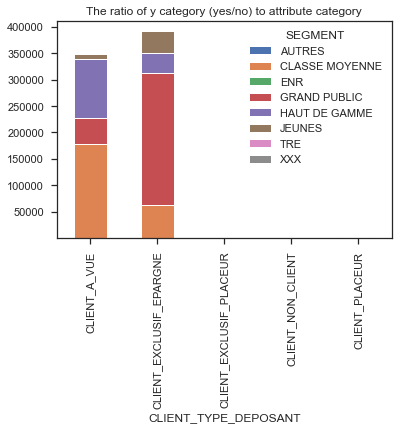

[Each row sums up to 1]
SEGMENT                    AUTRES  CLASSE MOYENNE       ENR  GRAND PUBLIC  \
CLIENT_TYPE_DEPOSANT                                                        
CLIENT_A_VUE             0.000003        0.512997  0.000006      0.136026   
CLIENT_EXCLUSIF_EPARGNE  0.000003        0.160584  0.000000      0.637578   
CLIENT_EXCLUSIF_PLACEUR  0.000000        0.226190  0.000000      0.000000   
CLIENT_NON_CLIENT        0.000000        0.000000  0.000000      1.000000   
CLIENT_PLACEUR           0.000000        0.139809  0.000000      0.083522   

SEGMENT                  HAUT DE GAMME    JEUNES       TRE       XXX  
CLIENT_TYPE_DEPOSANT                                                  
CLIENT_A_VUE                  0.321468  0.029294  0.000032  0.000175  
CLIENT_EXCLUSIF_EPARGNE       0.097135  0.104657  0.000015  0.000028  
CLIENT_EXCLUSIF_PLACEUR       0.702381  0.071429  0.000000  0.000000  
CLIENT_NON_CLIENT             0.000000  0.000000  0.000000  0.000000  
CLIENT_PLA

In [95]:
plot(data.CLIENT_TYPE_DEPOSANT)

In [96]:
data['AGENCE'].unique()


array(['A1', 'A2', 'A3', 'A4', 'A6', 'A7', 'A8', 'A9', 'B1', 'B2', 'B3',
       'B4', 'B6', 'B7', 'B8', 'B9', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6',
       'C7', 'C8', 'C9', 'D1', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9',
       'K1', 'K2', 'K3', 'K4', 'K5', 'K6', 'K7', 'K8', 'K9', 'L1', 'L2',
       'L3', 'L4', 'L5', 'L6', 'L7', 'L8', 'L9', 'M1', 'M2', 'M3', 'M4',
       'M5', 'M6', 'M7', 'M8', 'M9', 'N1', 'N2', 'N3', 'N4', 'N5', 'N6',
       'N7', 'N8', 'N9', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8',
       'P9', 'R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'R9', 'S1',
       'S2', 'S3', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9', 'T1', 'T2', 'T3',
       'T4', 'T5', 'T6', 'T7', 'T8', 'T9', 'U1', 'U2', 'U3', 'U4', 'U5',
       'U6', 'U7', 'U8', 'U9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7',
       'V8', 'V9', 'X1', 'X2', '00', 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
       12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28,
       29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 

<AxesSubplot:>

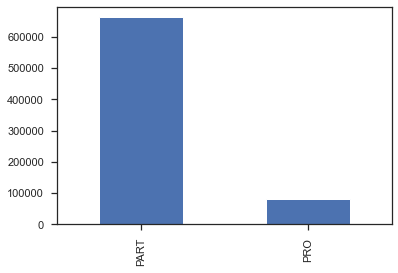

In [97]:
data.MARCHE.value_counts()[:10].plot(kind='bar')


## Relationship Analysis

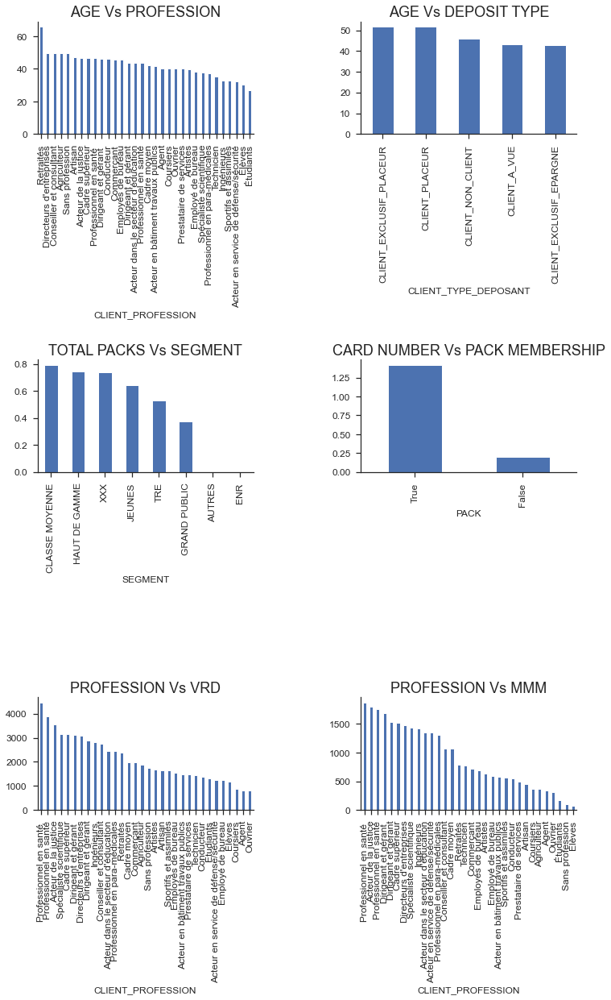

In [98]:
fig, axarr = plt.subplots(3, 2, figsize=(12, 18))
data.groupby('CLIENT_PROFESSION')['CLIENT_AGE'].mean().sort_values(ascending=False).plot.bar(ax=axarr[0][0], fontsize=12)
axarr[0][0].set_title("AGE Vs PROFESSION", fontsize=18)

data.groupby('CLIENT_TYPE_DEPOSANT')['CLIENT_AGE'].mean().sort_values(ascending=False).plot.bar(ax=axarr[0][1], fontsize=12)
axarr[0][1].set_title("AGE Vs DEPOSIT TYPE", fontsize=18)

data.groupby('SEGMENT')['TOTAL_PACK'].mean().sort_values(ascending=False).plot.bar(ax=axarr[1][0], fontsize=12)
axarr[1][0].set_title("TOTAL PACKS Vs SEGMENT", fontsize=18)

data.groupby('PACK')['CLIENT_NOMBRE_CARTES'].mean().sort_values(ascending=False).plot.bar(ax=axarr[1][1], fontsize=12)
axarr[1][1].set_title("CARD NUMBER Vs PACK MEMBERSHIP", fontsize=18)

data.groupby('CLIENT_PROFESSION')['CLIENT_VRD_MOY'].mean().sort_values(ascending=False).plot.bar(ax=axarr[2][0], fontsize=12)
axarr[2][0].set_title("PROFESSION Vs VRD", fontsize=18)

data.groupby('CLIENT_PROFESSION')['CLIENT_MMM'].mean().sort_values(ascending=False).plot.bar(ax=axarr[2][1], fontsize=12)
axarr[2][1].set_title("PROFESSION Vs MMM", fontsize=18)

plt.subplots_adjust(hspace=2.0)
plt.subplots_adjust(wspace=.5)
sns.despine()

### Data reduction

In [99]:
data = data.drop(columns= ['CLIENT_ENCOURS_A_VUE','CLIENT_NOMBRE_BIATNET','CLIENT_NOMBRE_OPCVM','CLIENT_NOMBRE_TITRES','CLIENT_NOMBRE_PROJET_AVENIR','CLIENT_ID','AGENCE','SEGMENT','SOUS SEGMENT','CLIENT_ENROLES','CLIENT_ENTREE_FINAL','PACK','MARCHE','VALEUR','CLIENT_NOMBRE_FAMILIA','CLIENT_NOMBRE_MESSAGIS','CLIENT_REVENUS_MENSUELS_NETS'])

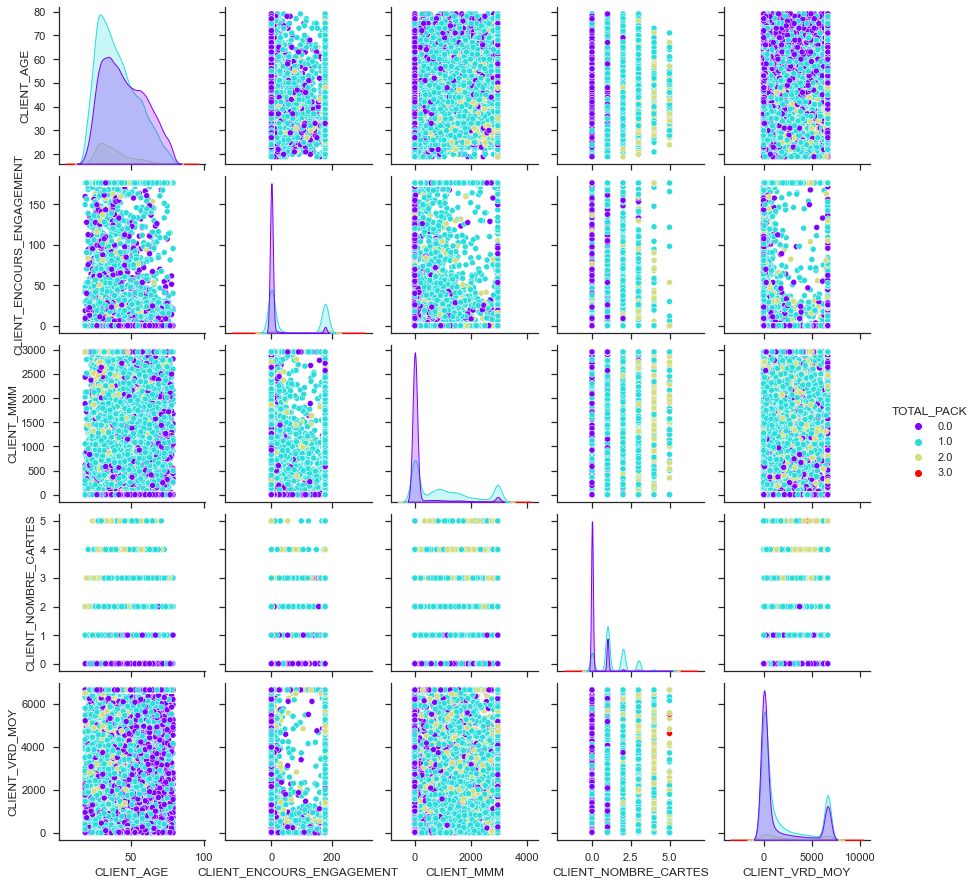

In [100]:
sns.pairplot(data.sample(n=50000),hue='TOTAL_PACK',palette='rainbow')

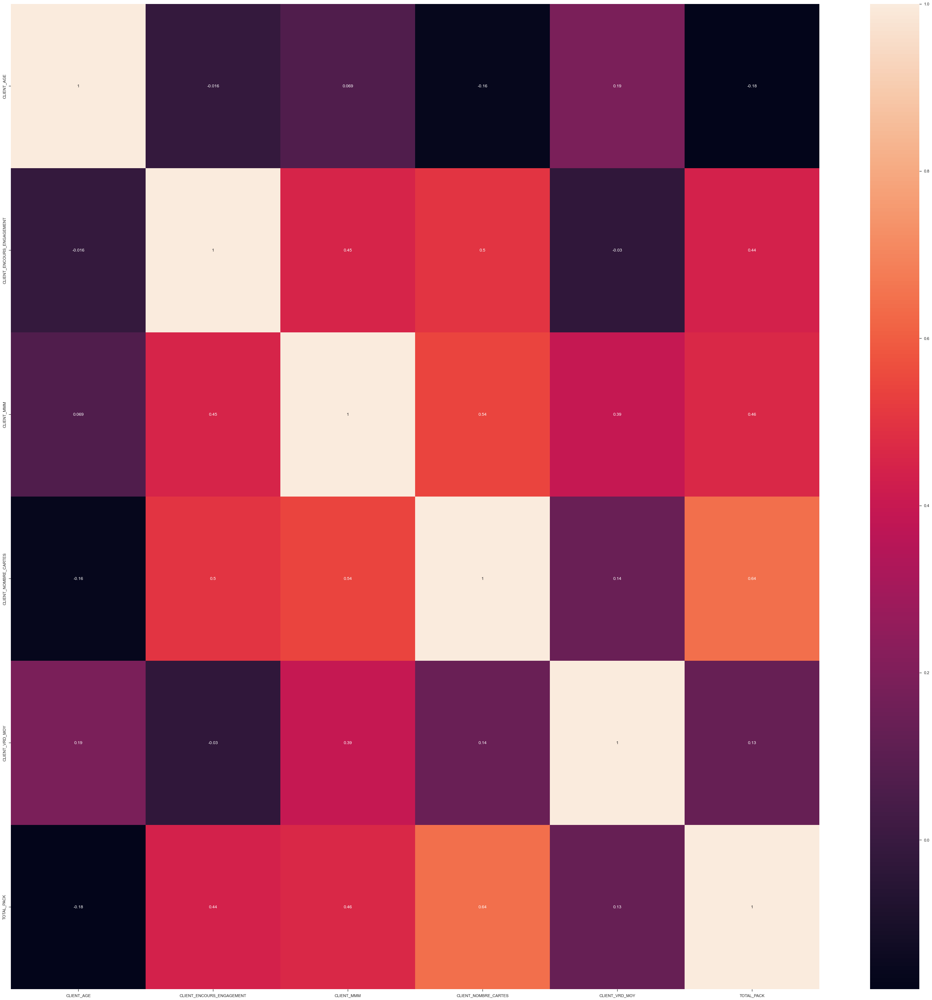

In [101]:
correlation = data.corr()
correlation
plt.figure(figsize=(50,50))
sns.heatmap(correlation, xticklabels=correlation.columns , yticklabels=correlation.columns , annot=True)
plt.savefig('figure1.png')
plt.show()

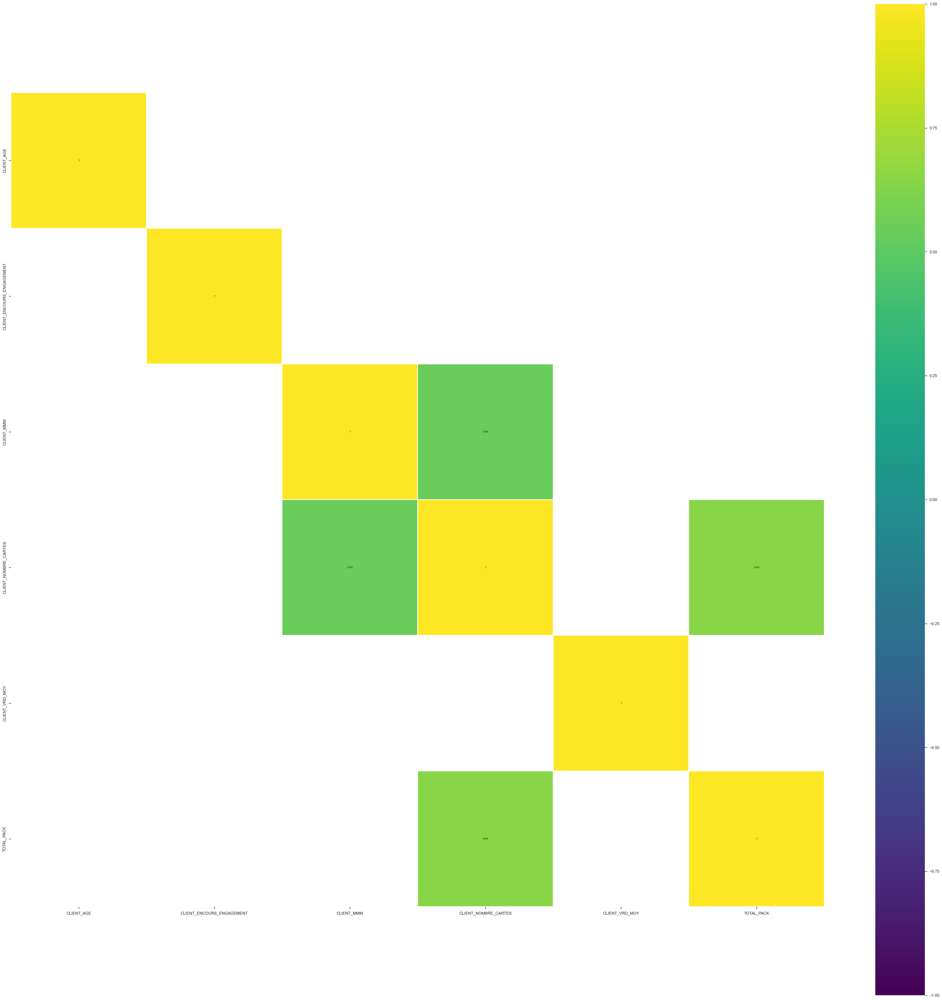

In [102]:
plt.figure(figsize=(50, (50)))

sns.heatmap(correlation[(correlation >= 0.5) | (correlation <= -0.4)],
            cmap='viridis', vmax=1.0, vmin=-1.0, linewidths=0.1,
            annot=True, annot_kws={"size": 8}, square=True);

In [103]:
data.corr()

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_VRD_MOY,TOTAL_PACK
CLIENT_AGE,1.000000,-0.016378,0.069281,-0.161171,0.186538,-0.178431
CLIENT_ENCOURS_ENGAGEMENT,-0.016378,1.000000,0.447925,0.498627,-0.029685,0.440892
CLIENT_MMM,0.069281,0.447925,1.000000,0.543113,0.393993,0.463931
CLIENT_NOMBRE_CARTES,-0.161171,0.498627,0.543113,1.000000,0.142612,0.644047
CLIENT_VRD_MOY,0.186538,-0.029685,0.393993,0.142612,1.000000,0.132922
TOTAL_PACK,-0.178431,0.440892,0.463931,0.644047,0.132922,1.000000


# Feature Scaling 

### Label Encoder

In [104]:
encoder = LabelEncoder()
data_encoded = data.copy()
data_encoded.CLIENT_PROFESSION = encoder.fit_transform(data_encoded.CLIENT_PROFESSION)
data_encoded.CLIENT_TYPE_DEPOSANT = encoder.fit_transform(data_encoded.CLIENT_TYPE_DEPOSANT)


In [105]:
data_encoded

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK
0,51,176.48125,916.666,0,14,0,0.000000,1.0
1,58,84.39600,0.000,0,14,0,0.000000,1.0
2,57,176.48125,1252.316,1,0,0,2933.309050,1.0
3,52,176.48125,1748.310,3,1,0,349.795150,1.0
4,58,0.00000,216.331,0,1,0,1373.050000,0.0
...,...,...,...,...,...,...,...,...
834748,39,0.00000,0.000,0,11,1,68.235600,0.0
834749,51,0.00000,0.000,1,10,4,1036.870605,0.0
834750,45,0.00000,0.000,0,6,1,1724.586350,0.0
834751,38,176.48125,0.000,1,11,0,17.436850,0.0


### MinMaxScaler

In [106]:
scaler = MinMaxScaler()
model=scaler.fit(data_encoded)
scaled=model.transform(data_encoded)
scaled_df = pd.DataFrame(scaled,columns=data_encoded.columns)
scaled_df.head()

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK
0,0.533333,1.000000,0.309948,0.0,0.451613,0.0,0.000000,0.25
1,0.650000,0.478215,0.000000,0.0,0.451613,0.0,0.000000,0.25
2,0.633333,1.000000,0.423440,0.2,0.000000,0.0,0.442103,0.25
3,0.550000,1.000000,0.591148,0.6,0.032258,0.0,0.052721,0.25
4,0.650000,0.000000,0.073147,0.0,0.032258,0.0,0.206944,0.00


# Cluster Analysis

### Elbow method

In [107]:
temp = scaled_df.sample(n=50000)

In [108]:
X1 = temp[['CLIENT_AGE' , 'CLIENT_VRD_MOY']].iloc[: , :].values
inertia = []
s_scores = []
for n in range(2 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)
    silhouette_avg = silhouette_score(X1, algorithm.labels_)
    s_scores.append(silhouette_avg) # data for the silhouette score method

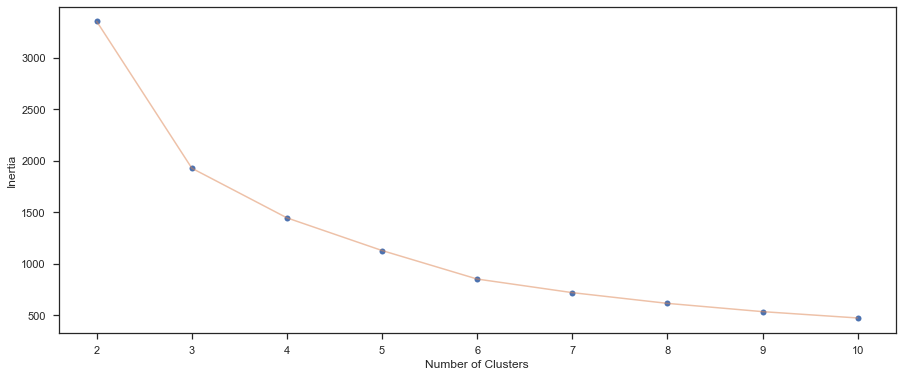

In [109]:
#The Elbow Chart
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(2 , 11) , inertia , 'o')
plt.plot(np.arange(2 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

It is unclear which clusters to go for 4 or 5 or 6. Here we use The Silhouette Method. The silhouette value measures how similar a point is to its own cluster (cohesion) compared to other clusters (separation).The range of the Silhouette value is between +1 and -1. A high value is desirable and indicates that the point is placed in the correct cluster. If many points have a negative Silhouette value, it may indicate that we have created too many or too few clusters.

A high Silhouette Score is desirable. The Silhouette Score reaches its global maximum at the optimal k. This should ideally appear as a peak in the Silhouette Value-versus-k plot.

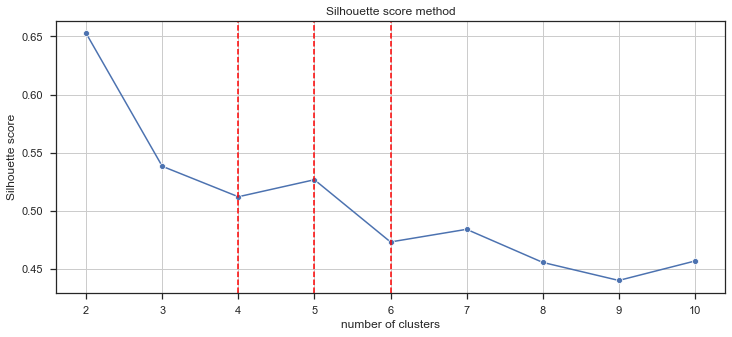

In [110]:
fig, ax = plt.subplots(figsize=(12,5))
ax = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax)
ax.set_title("Silhouette score method")
ax.set_xlabel("number of clusters")
ax.set_ylabel("Silhouette score")
ax.axvline(4, ls="--", c="red")
ax.axvline(5, ls="--", c="red")
ax.axvline(6, ls="--", c="red")
plt.grid()
plt.show()

We see that silhoutte score is maximum at k=5. So we go ahead and take that value

The Elbow Method is more of a decision rule, while the Silhouette is a metric used for validation while clustering. Thus, it can be used in combination with the Elbow Method.

In [111]:
algorithm = (KMeans(n_clusters = 5 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_

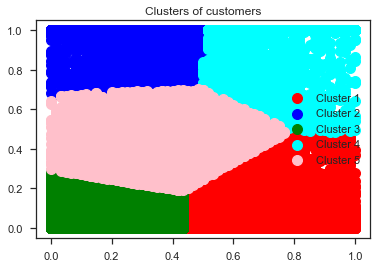

In [112]:
#Plotting the clusters
plt.scatter(X1[labels1 == 0, 0], X1[labels1 == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(X1[labels1 == 1, 0], X1[labels1 == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(X1[labels1 == 2, 0], X1[labels1 == 2, 1], s = 100, c = 'green', label = 'Cluster 3')
plt.scatter(X1[labels1 == 3, 0], X1[labels1 == 3, 1], s = 100, c = 'cyan', label = 'Cluster 4')
plt.scatter(X1[labels1 == 4, 0], X1[labels1 == 4, 1], s = 100, c = 'pink', label = 'Cluster 5')
plt.title('Clusters of customers')
plt.legend()
plt.show()

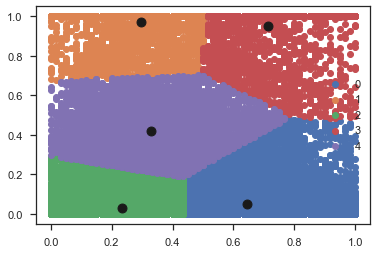

In [113]:
#Getting the Centroids
centroids =algorithm.cluster_centers_
u_labels = np.unique(labels1)
 
#plotting the results:
 
for i in u_labels:
    plt.scatter(X1[labels1 == i , 0] , X1[labels1 == i , 1] , label = i)
plt.scatter(centroids[:,0] , centroids[:,1] , s = 80, color = 'k')
plt.legend()
plt.show()

### Perfoming segmentation using all the numeric variables

In [114]:
X = temp[['CLIENT_AGE' ,'CLIENT_MMM' ,'CLIENT_ENCOURS_ENGAGEMENT','CLIENT_VRD_MOY','TOTAL_PACK']]
inertia = []
s_scores = []
for n in range(2 , 11):
    algorithm = KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan').fit(X) 
    inertia.append(algorithm.inertia_)
    silhouette_avg = silhouette_score(X, algorithm.labels_)
    s_scores.append(silhouette_avg) # data for the silhouette score method

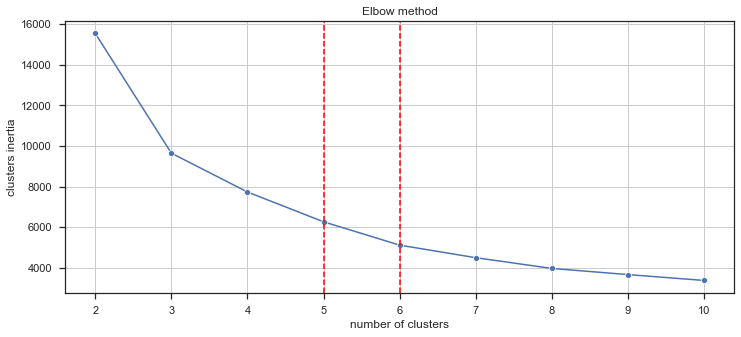

In [115]:
fig, ax = plt.subplots(figsize=(12,5))
ax = sns.lineplot(np.arange(2 , 11), inertia, marker='o', ax=ax)
ax.set_title("Elbow method")
ax.set_xlabel("number of clusters")
ax.set_ylabel("clusters inertia")
ax.axvline(5, ls="--", c="red")
ax.axvline(6, ls="--", c="red")
plt.grid()
plt.show()

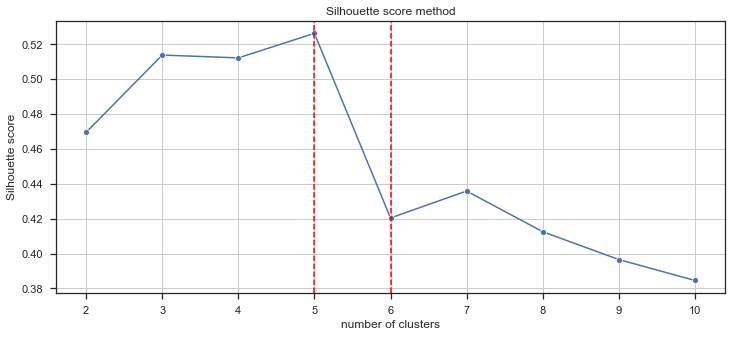

In [116]:
fig, ax = plt.subplots(figsize=(12,5))
ax = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax)
ax.set_title("Silhouette score method")
ax.set_xlabel("number of clusters")
ax.set_ylabel("Silhouette score")
ax.axvline(5, ls="--", c="red")
ax.axvline(6, ls="--", c="red")

plt.grid()
plt.show()

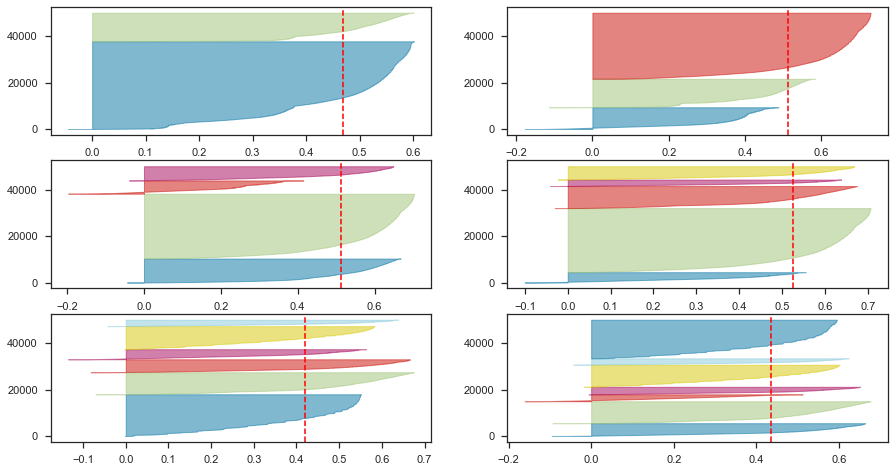

In [117]:
fig, ax = plt.subplots(3, 2, figsize=(15,8))
for i in [2,3, 4, 5,6,7]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(X) 

In [118]:
#For clusters of K=6
KM6 = (KMeans(n_clusters = 6 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
KM6.fit(X)
labels6 = KM6.labels_
centroids6 = KM6.cluster_centers_
KM6_df = temp.copy()
KM6_df['labels'] = labels6

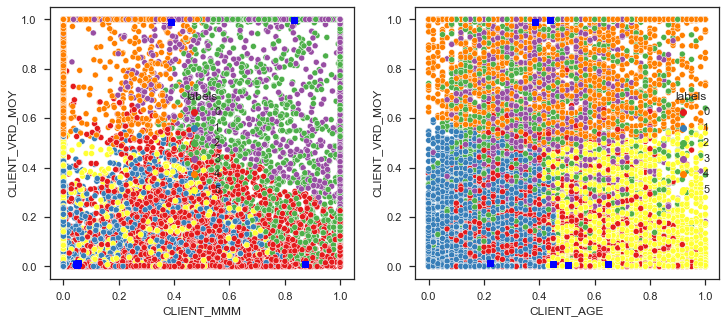

In [119]:
fig1, (axes) = plt.subplots(1,2,figsize=(12,5))


scat_1 = sns.scatterplot('CLIENT_MMM', 'CLIENT_VRD_MOY', data=KM6_df,
                hue='labels', ax=axes[0], palette='Set1', legend='full')

sns.scatterplot('CLIENT_AGE', 'CLIENT_VRD_MOY', data=KM6_df,
                hue='labels', palette='Set1', ax=axes[1], legend='full')

axes[0].scatter(centroids6[:,1],centroids6[:,2], marker='s', s=40, c="blue")
axes[1].scatter(centroids6[:,0],centroids6[:,2], marker='s', s=40, c="blue")
plt.show()

In [120]:
KM_clust_sizes = KM6_df.groupby('labels').size().to_frame()
KM_clust_sizes.columns = ["KM_size"]
KM_clust_sizes

,KM_size
labels,
0,9469
1,17963
2,4336
3,2765
4,5562
5,9905


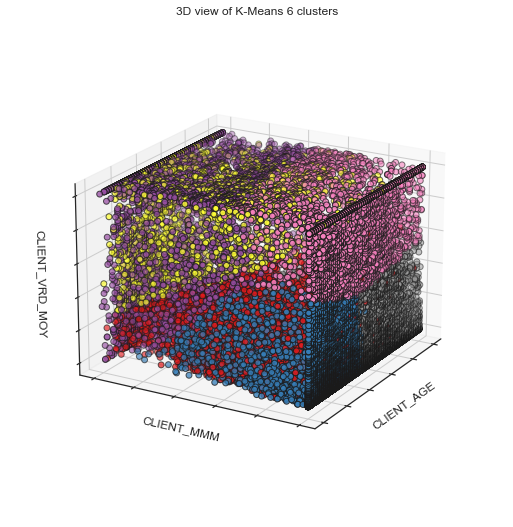

In [121]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(7, 7))
ax = Axes3D(fig, rect=[0, 0, .99, 1], elev=20, azim=210)
ax.scatter(KM6_df['CLIENT_AGE'],
           KM6_df['CLIENT_MMM'],
           KM6_df['CLIENT_VRD_MOY'],
           c=KM6_df['labels'],
           s=35, edgecolor='k', cmap=plt.cm.Set1)

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('CLIENT_AGE')
ax.set_ylabel('CLIENT_MMM')
ax.set_zlabel('CLIENT_VRD_MOY')
ax.set_title('3D view of K-Means 6 clusters')
ax.dist = 12

plt.show()

In [122]:
import plotly as py
import plotly.graph_objs as go
def tracer(db, n, name):
    '''
    This function returns trace object for Plotly
    '''
    return go.Scatter3d(
        x = db[db['labels']==n]['CLIENT_AGE'],
        y = db[db['labels']==n]['CLIENT_VRD_MOY'],
        z = db[db['labels']==n]['CLIENT_MMM'],
        mode = 'markers',
        name = name,
        marker = dict(
            color = KM6_df['labels'],
            size = 5,
            line=dict(
            color= KM6_df['labels'],
            width= 12
        ),
        opacity=0.8
        )
     )

trace0 = tracer(KM6_df, 0, 'Cluster 0')
trace1 = tracer(KM6_df, 1, 'Cluster 1')
trace2 = tracer(KM6_df, 2, 'Cluster 2')
trace3 = tracer(KM6_df, 3, 'Cluster 3')
trace4 = tracer(KM6_df, 4, 'Cluster 4')
trace5 = tracer(KM6_df, 5, 'Cluster 5')
trace_data = [trace0, trace1, trace2, trace3, trace4, trace5]

layout = go.Layout(
    title = 'Clusters with k=6 wrt Age, Income and Spending Scores',
    scene = dict(
            xaxis = dict(title = 'Age'),
            yaxis = dict(title = 'Spending Score'),
            zaxis = dict(title = 'Annual Income')
        )
)

fig = go.Figure(data=trace_data, layout=layout)
py.offline.iplot(fig)

In [123]:
db_index = davies_bouldin_score(X, labels6)
print("Davies Bouldin Index: %0.2f"%db_index)

Davies Bouldin Index: 0.92


In [124]:
#For clusters of K=5
KM5 = (KMeans(n_clusters = 5 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
KM5.fit(X)
labels5 = KM5.labels_
centroids5 = KM5.cluster_centers_
KM5_df = temp.copy()
KM5_df['labels'] = labels5

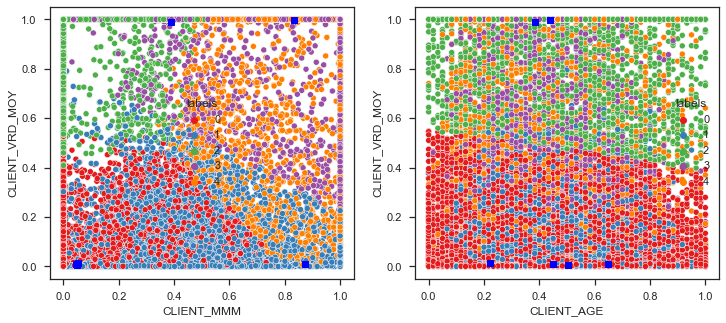

In [125]:
fig1, (axes) = plt.subplots(1,2,figsize=(12,5))


scat_1 = sns.scatterplot('CLIENT_MMM', 'CLIENT_VRD_MOY', data=KM5_df,
                hue='labels', ax=axes[0], palette='Set1', legend='full')

sns.scatterplot('CLIENT_AGE', 'CLIENT_VRD_MOY', data=KM5_df,
                hue='labels', palette='Set1', ax=axes[1], legend='full')

axes[0].scatter(centroids6[:,1],centroids6[:,2], marker='s', s=40, c="blue")
axes[1].scatter(centroids6[:,0],centroids6[:,2], marker='s', s=40, c="blue")
plt.show()

In [126]:
KM_clust_sizes5 = KM5_df.groupby('labels').size().to_frame()
KM_clust_sizes5.columns = ["KM_size"]
KM_clust_sizes5

,KM_size
labels,
0,27566
1,9484
2,5743
3,2763
4,4444


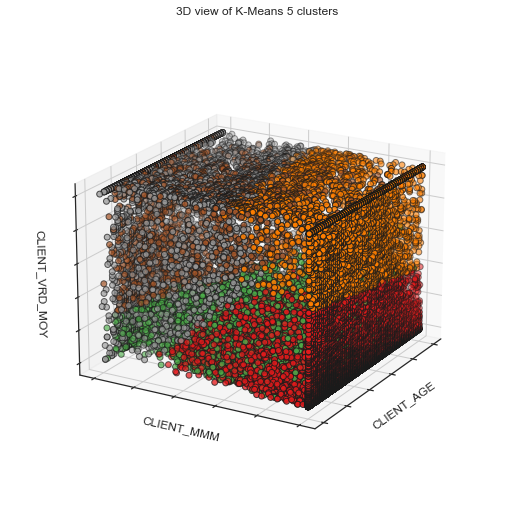

In [127]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(7, 7))
ax = Axes3D(fig, rect=[0, 0, .99, 1], elev=20, azim=210)
ax.scatter(KM5_df['CLIENT_AGE'],
           KM5_df['CLIENT_MMM'],
           KM5_df['CLIENT_VRD_MOY'],
           c=KM5_df['labels'],
           s=35, edgecolor='k', cmap=plt.cm.Set1)

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('CLIENT_AGE')
ax.set_ylabel('CLIENT_MMM')
ax.set_zlabel('CLIENT_VRD_MOY')
ax.set_title('3D view of K-Means 5 clusters')
ax.dist = 12

plt.show()

In [128]:
trace0 = tracer(KM5_df, 0, 'Cluster 0')
trace1 = tracer(KM5_df, 1, 'Cluster 1')
trace2 = tracer(KM5_df, 2, 'Cluster 2')
trace3 = tracer(KM5_df, 3, 'Cluster 3')
trace4 = tracer(KM5_df, 4, 'Cluster 4')

trace_data5 = [trace0, trace1, trace2, trace3, trace4]

layout = go.Layout(
    title = 'Clusters wrt Age, Income and Spending Scores and k = 5',
    scene = dict(
            xaxis = dict(title = 'Age'),
            yaxis = dict(title = 'Spending Score'),
            zaxis = dict(title = 'Annual Income')
        )
)

fig = go.Figure(data=trace_data5, layout=layout)
py.offline.iplot(fig)

## Evaluation metrics

In [129]:
db_index = davies_bouldin_score(X, labels6)
print("Davies Bouldin Index: %0.2f"%db_index)
sc = metrics.silhouette_score(X, labels6)
print("Silhouette Coefficient:%0.2f"%sc)
ch_score = calinski_harabasz_score(X, labels6)
print("Calinski harabasz score:%0.2f"%ch_score)

Davies Bouldin Index: 0.92
Silhouette Coefficient:0.42
Calinski harabasz score:40324.80


In [130]:
db_index = davies_bouldin_score(X, labels5)
print("Davies Bouldin Index: %0.2f"%db_index)
sc = metrics.silhouette_score(X, labels5)
print("Silhouette Coefficient:%0.2f"%sc)
ch_score = calinski_harabasz_score(X, labels5)
print("Calinski harabasz score:%0.2f"%ch_score)

Davies Bouldin Index: 0.84
Silhouette Coefficient:0.53
Calinski harabasz score:38863.35


Clearly, the metrics show that using 5 clusters is more optimal

In [131]:
# calculate SC for K=2 through K=19
scores = []
for k in range(2,20):
    labels = KMeans(n_clusters=k).fit(X).labels_
    score = metrics.silhouette_score(X, labels)
    scores.append(score)

scores

[0.46954068092765716,
 0.5138604991582205,
 0.5122099113572987,
 0.5262700225728112,
 0.42040109487662564,
 0.4358438863341281,
 0.41247688852935416,
 0.39600510845887715,
 0.3848489676446466,
 0.36927239836625175,
 0.3607123706180566,
 0.37087367993795056,
 0.3491170194419902,
 0.37117832087908975,
 0.3432624683830541,
 0.3542450335211789,
 0.35624165493993437,
 0.35950497934420367]

The highest silhouette score is for k=5 ( 0.5217648399961166)

## Improve kmeans with PCA

In [132]:
# This time the client's profession feature will be added
x_pca = temp[['CLIENT_AGE' ,'CLIENT_MMM' ,'CLIENT_ENCOURS_ENGAGEMENT','CLIENT_VRD_MOY','TOTAL_PACK','CLIENT_PROFESSION']]
pcamodel = PCA(n_components=0.85)
pca = pcamodel.fit_transform(x_pca)
pca.shape

(50000, 4)

the algorithm automatically selects the best number of principal components that keep 85% of the variance in the original data.

In [133]:
# know how many components that the algorithm has selected
pcamodel.n_components_

4

In [134]:
pcamodel.explained_variance_ 


array([0.24137679, 0.16263663, 0.07410932, 0.05622784])

pca explains the variance ratio of 85% with n_component: 4

In [135]:
pcamodel.explained_variance_ratio_


array([0.40539324, 0.27314883, 0.12446688, 0.09443486])

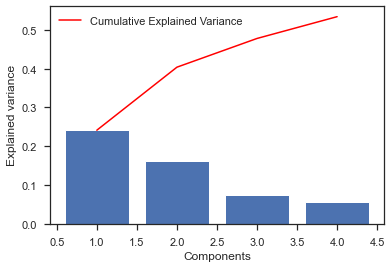

In [136]:
# Bar plot of explained_variance
plt.bar(range(1,len(pcamodel.explained_variance_ )+1),pcamodel.explained_variance_ )
plt.ylabel('Explained variance')
plt.xlabel('Components')
plt.plot(range(1,len(pcamodel.explained_variance_ )+1),
         np.cumsum(pcamodel.explained_variance_),
         c='red',
         label="Cumulative Explained Variance")
plt.legend(loc='upper left')

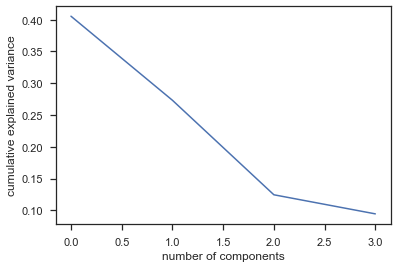

In [137]:
plt.plot(pcamodel.explained_variance_ratio_)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

#PCA1 is at 0 in xscale


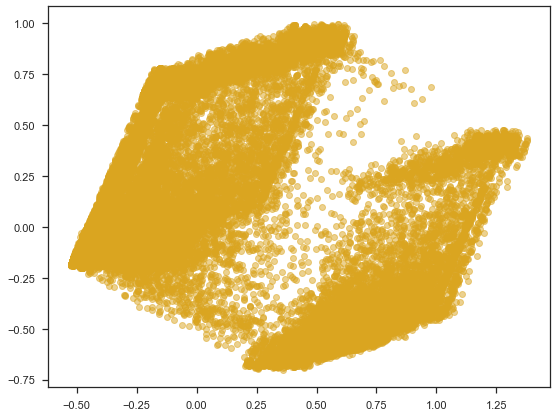

In [138]:
plt.figure(figsize = (9,7))
plt.scatter(pca[:, 0], pca[:, 1], c='goldenrod',alpha=0.5)
plt.show()

A rule of thumb is to preserve around 80 % of the variance. So, in this instance, we decide to keep 3 components.

<AxesSubplot:>

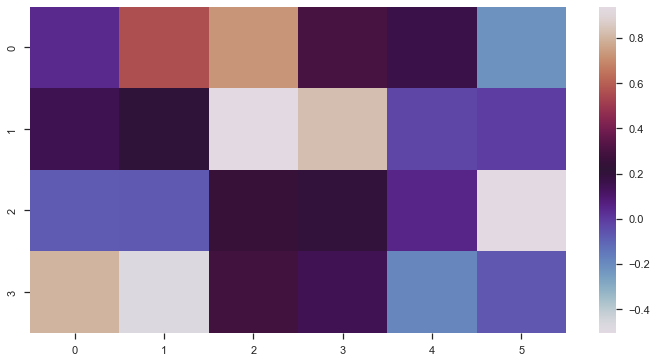

In [139]:
map= pd.DataFrame(pcamodel.components_)
plt.figure(figsize=(12,6))
sns.heatmap(map,cmap='twilight')

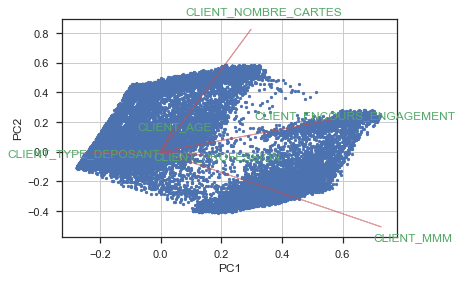

In [140]:
def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley,s=5)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'green', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')
 
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.grid()

myplot(pca[:,0:2],np.transpose(pcamodel.components_[0:2, :]),list(data.columns))
plt.show()

In [141]:
pcamodel.get_params()

{'copy': True,
 'iterated_power': 'auto',
 'n_components': 0.85,
 'n_oversamples': 10,
 'power_iteration_normalizer': 'auto',
 'random_state': None,
 'svd_solver': 'auto',
 'tol': 0.0,
 'whiten': False}

In [142]:
wcss=[]
for i in range(1,11):
    kmeans_pca = KMeans(n_clusters= i, init='k-means++', random_state=0)
    kmeans_pca.fit(pca)
    wcss.append(kmeans_pca.inertia_)

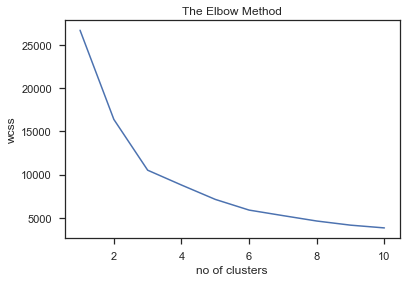

In [143]:
plt.plot(range(1,11), wcss)
plt.title('The Elbow Method')
plt.xlabel('no of clusters')
plt.ylabel('wcss')
plt.show()

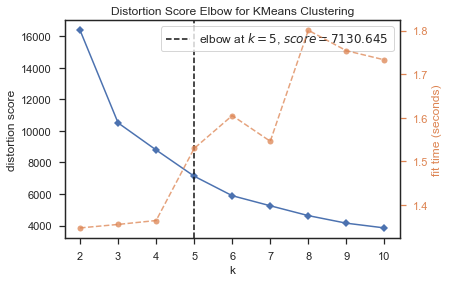

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [144]:
elbow_graph = KElbowVisualizer(KMeans(random_state=43), k=10)
elbow_graph.fit(pca)
elbow_graph.show()

In [145]:
kmeans_pca = KMeans(n_clusters=4, init='k-means++', random_state=42)

In [146]:
label_pca = kmeans_pca.fit_predict(pca)

In [147]:

db_index = davies_bouldin_score(pca, label_pca)
print("Davies Bouldin Index: %0.2f"%db_index)
sc = metrics.silhouette_score(pca, label_pca)
print("Silhouette Coefficient:%0.2f"%sc)
ch_score = calinski_harabasz_score(pca, label_pca)
print("Calinski harabasz score:%0.2f"%ch_score)


Davies Bouldin Index: 0.96
Silhouette Coefficient:0.38
Calinski harabasz score:33961.70


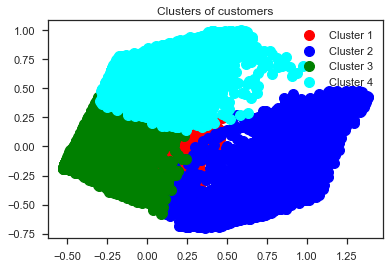

In [148]:
plt.scatter(pca[label_pca == 0, 0], pca[label_pca == 0, 1], s = 100, c = 'red', label = 'Cluster 1')
plt.scatter(pca[label_pca == 1, 0], pca[label_pca == 1, 1], s = 100, c = 'blue', label = 'Cluster 2')
plt.scatter(pca[label_pca == 2, 0], pca[label_pca == 2, 1], s = 100, c = 'green', label = 'Cluster 3')
plt.scatter(pca[label_pca == 3, 0], pca[label_pca == 3, 1], s = 100, c = 'cyan', label = 'Cluster 4')

plt.title('Clusters of customers')
plt.legend()
plt.show()

In [149]:
kmeans_pca = KMeans(n_clusters=3, init='k-means++', random_state=42)

In [150]:
label_pca = kmeans_pca.fit_predict(pca)

In [151]:
db_index = davies_bouldin_score(pca, label_pca)
print("Davies Bouldin Index: %0.2f"%db_index)
sc = metrics.silhouette_score(pca, label_pca)
print("Silhouette Coefficient:%0.2f"%sc)
ch_score = calinski_harabasz_score(pca, label_pca)
print("Calinski harabasz score:%0.2f"%ch_score)

Davies Bouldin Index: 0.92
Silhouette Coefficient:0.47
Calinski harabasz score:38534.26


The silhouette score is higher , the davies Bouldin score is lower, and the calinski harabasz is higher so the chosen value for the number of clusters is k = 3

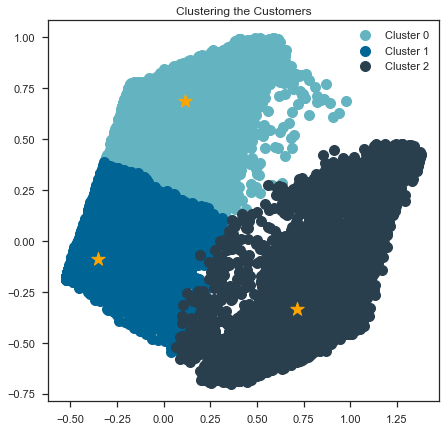

In [155]:
fig, axes = plt.subplots(1,1,figsize=(7,7))
Cluster_0=plt.scatter(pca[label_pca ==0,0], pca[label_pca == 0,1], s=100, c='#63b3c0')
Cluster_1=plt.scatter(pca[label_pca ==1,0], pca[label_pca == 1,1], s=100, c='#006494')
Cluster_2=plt.scatter(pca[label_pca ==2,0], pca[label_pca == 2,1], s=100, c='#293f4e')


plt.scatter(kmeans_pca.cluster_centers_[:,0],kmeans_pca.cluster_centers_[:,1],color='orange',marker='*',label='centroid',s=200)
plt.title('Clustering the Customers')
plt.legend([Cluster_0,Cluster_1,Cluster_2],['Cluster 0','Cluster 1','Cluster 2'])

In [156]:
data_pca = pd.concat([temp.reset_index(drop=True),pd.DataFrame(pca)],axis=1)
data_pca.columns.values[-3:]=['Component 1','Component 2','Component 3']
data_pca['SEGMENT_PCA'] = kmeans_pca.labels_

In [157]:
data_pca


,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3,SEGMENT_PCA
0,0.633333,0.000000,1.000000,0.6,0.258065,0.00,0.974288,0.25,0.550564,0.914327,-0.260721,-0.145008,0
1,0.433333,0.145041,0.156169,0.2,0.645161,0.00,0.014642,0.25,-0.193248,-0.160433,0.025819,-0.029576,1
2,0.933333,0.000000,0.453050,0.2,0.000000,0.00,1.000000,0.25,0.321793,0.866200,-0.480355,0.373832,0
3,0.500000,0.000000,0.000000,0.0,0.580645,0.25,0.003033,0.00,-0.412280,-0.112597,-0.080160,0.105969,1
4,0.500000,1.000000,1.000000,0.4,0.258065,0.00,0.025342,0.25,0.987932,-0.391208,-0.185449,-0.104551,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,0.466667,0.000000,0.000000,0.0,0.064516,0.25,0.029838,0.00,-0.291437,-0.091596,-0.556527,0.118588,1
49996,0.200000,0.000000,0.000000,0.2,0.645161,0.25,0.905150,0.25,-0.130126,0.577280,0.197155,-0.055443,0
49997,0.366667,0.000000,0.000000,0.2,0.645161,0.25,0.010298,0.00,-0.429549,-0.127069,-0.007747,-0.003813,1
49998,0.133333,0.000000,0.000000,0.2,0.645161,0.25,0.000143,0.00,-0.441580,-0.170346,0.008444,-0.191473,1


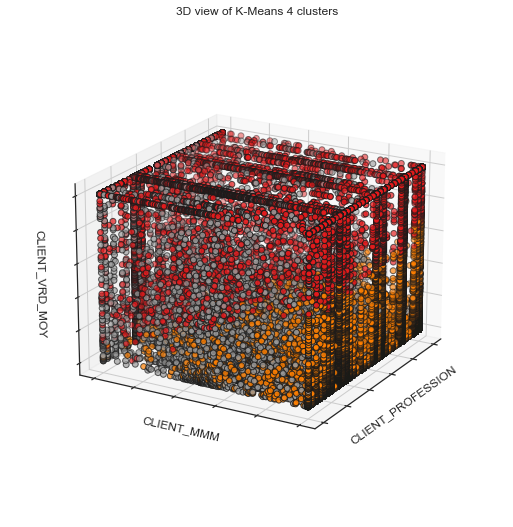

In [158]:
fig = plt.figure(figsize=(7, 7))
ax = Axes3D(fig, rect=[0, 0, .99, 1], elev=20, azim=210)
ax.scatter(data_pca['CLIENT_PROFESSION'],
           data_pca['CLIENT_MMM'],
           data_pca['CLIENT_VRD_MOY'],
           c=data_pca['SEGMENT_PCA'],
           s=35, edgecolor='k', cmap=plt.cm.Set1)

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('CLIENT_PROFESSION')
ax.set_ylabel('CLIENT_MMM')
ax.set_zlabel('CLIENT_VRD_MOY')
ax.set_title('3D view of K-Means 4 clusters')
ax.dist = 12

plt.show()

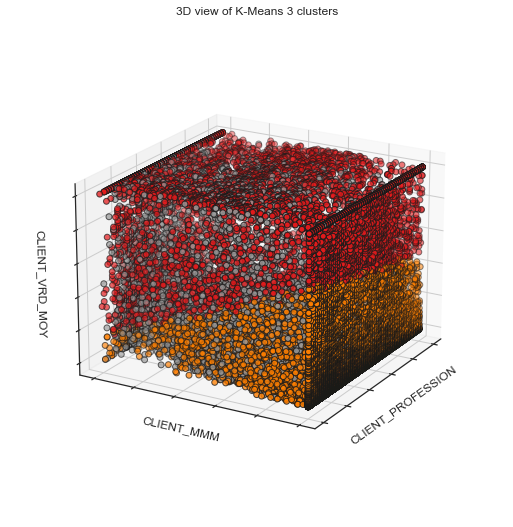

In [159]:
fig = plt.figure(figsize=(7, 7))
ax = Axes3D(fig, rect=[0, 0, .99, 1], elev=20, azim=210)
ax.scatter(data_pca['CLIENT_AGE'],
           data_pca['CLIENT_MMM'],
           data_pca['CLIENT_VRD_MOY'],
           c=data_pca['SEGMENT_PCA'],
           s=35, edgecolor='k', cmap=plt.cm.Set1)

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('CLIENT_PROFESSION')
ax.set_ylabel('CLIENT_MMM')
ax.set_zlabel('CLIENT_VRD_MOY')
ax.set_title('3D view of K-Means 3 clusters')
ax.dist = 12

plt.show()

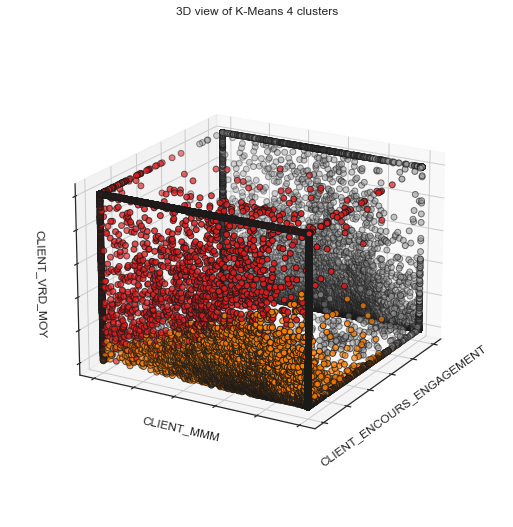

In [160]:
fig = plt.figure(figsize=(7, 7))
ax = Axes3D(fig, rect=[0, 0, .99, 1], elev=20, azim=210)
ax.scatter(data_pca['CLIENT_ENCOURS_ENGAGEMENT'],
           data_pca['CLIENT_MMM'],
           data_pca['CLIENT_VRD_MOY'],
           c=data_pca['SEGMENT_PCA'],
           s=35, edgecolor='k', cmap=plt.cm.Set1)

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('CLIENT_ENCOURS_ENGAGEMENT')
ax.set_ylabel('CLIENT_MMM')
ax.set_zlabel('CLIENT_VRD_MOY')
ax.set_title('3D view of K-Means 4 clusters')
ax.dist = 12

plt.show()

In [161]:
data_pca[data_pca['SEGMENT_PCA'] == 0]

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3,SEGMENT_PCA
0,0.633333,0.0,1.000000,0.6,0.258065,0.00,0.974288,0.25,0.550564,0.914327,-0.260721,-0.145008,0
2,0.933333,0.0,0.453050,0.2,0.000000,0.00,1.000000,0.25,0.321793,0.866200,-0.480355,0.373832,0
6,0.133333,0.0,0.761737,0.6,0.258065,0.00,0.286251,0.50,0.234442,0.216050,-0.329187,-0.577195,0
11,0.633333,0.0,0.000000,0.0,0.838710,0.25,0.819835,0.00,-0.221809,0.577319,0.315270,0.311804,0
17,0.266667,0.0,0.000000,0.0,0.838710,0.25,1.000000,0.00,-0.182511,0.670650,0.380013,0.045031,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
49972,0.383333,0.0,0.998480,0.6,0.258065,0.00,1.000000,0.50,0.587979,0.890897,-0.223358,-0.387047,0
49990,0.566667,0.0,0.912159,0.2,0.000000,0.00,1.000000,0.25,0.563709,0.908817,-0.485977,-0.135389,0
49992,0.566667,0.0,0.000000,0.0,0.838710,0.25,1.000000,0.00,-0.170917,0.715551,0.356580,0.284436,0
49993,0.366667,0.0,0.000000,0.2,0.645161,0.25,1.000000,0.25,-0.095536,0.680252,0.203144,0.091160,0


In [162]:
data_pca[data_pca['SEGMENT_PCA'] == 1]

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3,SEGMENT_PCA
1,0.433333,0.145041,0.156169,0.2,0.645161,0.00,0.014642,0.25,-0.193248,-0.160433,0.025819,-0.029576,1
3,0.500000,0.000000,0.000000,0.0,0.580645,0.25,0.003033,0.00,-0.412280,-0.112597,-0.080160,0.105969,1
5,0.383333,0.000000,0.000000,0.0,0.387097,0.25,0.001362,0.00,-0.374468,-0.129956,-0.253010,0.025894,1
8,0.633333,0.000000,0.000000,0.0,0.193548,0.25,0.002374,0.00,-0.321690,-0.090228,-0.453963,0.238809,1
12,0.483333,0.000000,0.000000,0.0,0.580645,0.25,0.003843,0.00,-0.412683,-0.114425,-0.078696,0.092785,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
49994,0.116667,0.168329,0.215285,0.4,0.645161,0.00,0.000845,0.25,-0.159742,-0.218383,0.049316,-0.305562,1
49995,0.466667,0.000000,0.000000,0.0,0.064516,0.25,0.029838,0.00,-0.291437,-0.091596,-0.556527,0.118588,1
49997,0.366667,0.000000,0.000000,0.2,0.645161,0.25,0.010298,0.00,-0.429549,-0.127069,-0.007747,-0.003813,1
49998,0.133333,0.000000,0.000000,0.2,0.645161,0.25,0.000143,0.00,-0.441580,-0.170346,0.008444,-0.191473,1


In [163]:
data_pca[data_pca['SEGMENT_PCA'] == 2]

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3,SEGMENT_PCA
4,0.500000,1.0,1.000000,0.4,0.258065,0.0,0.025342,0.25,0.987932,-0.391208,-0.185449,-0.104551,2
7,0.400000,1.0,0.481134,0.4,0.645161,0.0,0.014772,0.25,0.605879,-0.528011,0.222221,0.032410,2
9,0.266667,1.0,0.262139,0.0,0.000000,0.0,0.348568,0.25,0.720355,-0.314956,-0.289561,0.121416,2
10,0.566667,1.0,0.190365,0.6,0.645161,0.0,0.009000,0.25,0.448418,-0.569562,0.229745,0.301775,2
13,0.366667,1.0,0.000000,0.6,0.161290,0.0,0.082697,0.50,0.503711,-0.582444,-0.167159,0.228782,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
49971,0.100000,1.0,0.363748,0.0,0.645161,0.0,0.000000,0.25,0.524423,-0.609992,0.251454,-0.153729,2
49973,0.383333,1.0,1.000000,0.8,0.258065,0.0,1.000000,0.25,1.272676,0.393118,0.018969,-0.057898,2
49974,0.416667,1.0,0.288073,0.0,0.580645,0.0,0.186072,0.25,0.563944,-0.425105,0.209110,0.165784,2
49982,0.366667,1.0,1.000000,0.6,0.290323,0.0,1.000000,0.50,1.305191,0.383536,0.063112,-0.120348,2


<AxesSubplot:ylabel='count'>

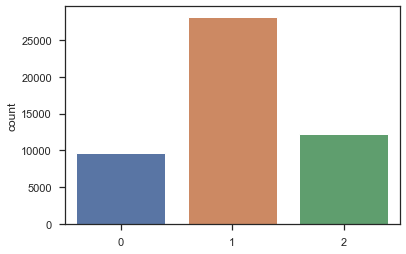

In [164]:
sns.countplot(label_pca)

In [165]:
data_pca.groupby('SEGMENT_PCA').mean().round(3)

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3
SEGMENT_PCA,,,,,,,,,,,,
0,0.491,0.006,0.405,0.183,0.524,0.118,0.880,0.157,0.116,0.687,0.023,0.010
1,0.371,0.012,0.053,0.097,0.596,0.199,0.053,0.100,-0.351,-0.088,-0.041,-0.031
2,0.396,0.989,0.492,0.349,0.445,0.000,0.241,0.261,0.717,-0.334,0.077,0.065


In [166]:
data_pca['SEGMENT_PCA'].value_counts()

1    28176
2    12252
0     9572
Name: SEGMENT_PCA, dtype: int64

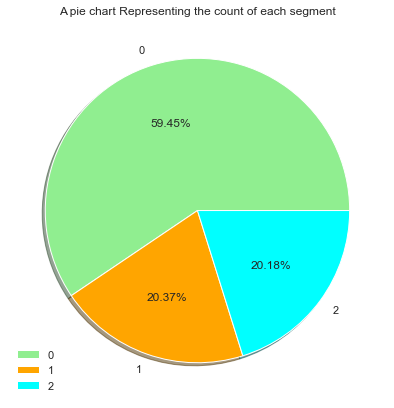

In [167]:
labels = ['0 ', '1','2']
size = [28052, 9614 , 9522]
colors = ['lightgreen', 'orange','cyan','pink']
explode = None

plt.rcParams['figure.figsize'] = (7, 7)
plt.pie(size, colors = colors, explode = explode, labels = labels, shadow = True, autopct = '%.2f%%')
plt.title('A pie chart Representing the count of each segment')
plt.axis('off')
plt.legend()
plt.show()

In [168]:
fig=px.scatter_3d(data_frame=x_pca,x='CLIENT_AGE',y='CLIENT_MMM',z='CLIENT_VRD_MOY',color=label_pca, color_continuous_scale='bluered')
fig.update_layout(
    title={
        'text': 'Customer Segmentation Based on Age, Average monthly flow and Actual values of deposits',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

<AxesSubplot:>

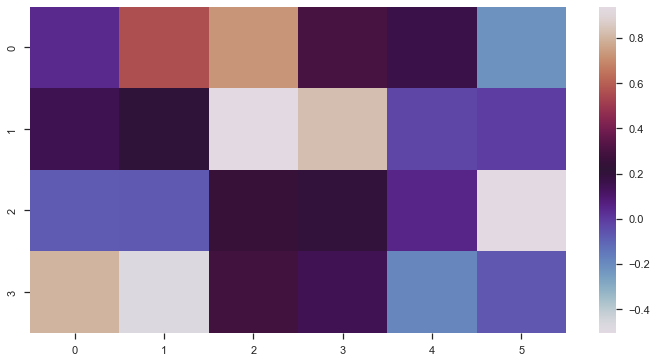

In [169]:
map= pd.DataFrame(pcamodel.components_)
plt.figure(figsize=(12,6))
sns.heatmap(map,cmap='twilight')

In [170]:
bins= [30,40,50,70,80]
labels=['Young Adult','Adult','Middle Aged','Senior Citizen']
data_pca['AgeGroup'] = pd.cut(data['CLIENT_AGE'], bins=bins, labels=labels, right=False)
print (data_pca)

       CLIENT_AGE  CLIENT_ENCOURS_ENGAGEMENT  CLIENT_MMM  \
0        0.633333                   0.000000    1.000000   
1        0.433333                   0.145041    0.156169   
2        0.933333                   0.000000    0.453050   
3        0.500000                   0.000000    0.000000   
4        0.500000                   1.000000    1.000000   
...           ...                        ...         ...   
49995    0.466667                   0.000000    0.000000   
49996    0.200000                   0.000000    0.000000   
49997    0.366667                   0.000000    0.000000   
49998    0.133333                   0.000000    0.000000   
49999    0.233333                   0.000000    0.000000   

       CLIENT_NOMBRE_CARTES  CLIENT_PROFESSION  CLIENT_TYPE_DEPOSANT  \
0                       0.6           0.258065                  0.00   
1                       0.2           0.645161                  0.00   
2                       0.2           0.000000                 

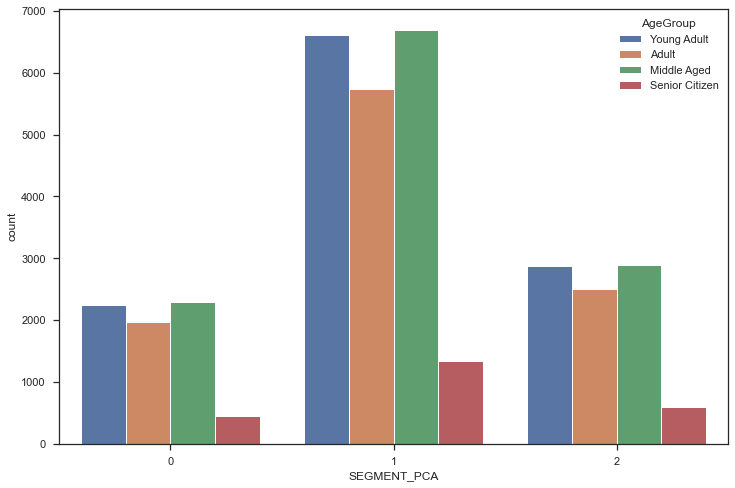

In [171]:
plt.figure(figsize=(12, 8))
sns.countplot(x='SEGMENT_PCA', data=data_pca, hue='AgeGroup')
plt.show()

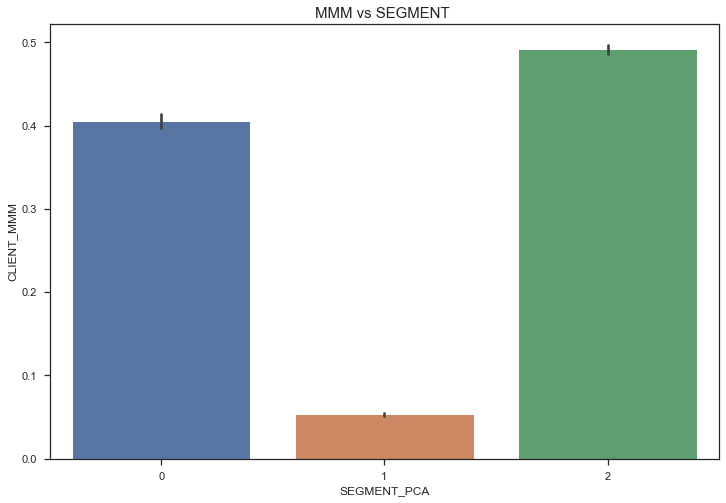

In [172]:
plt.figure(figsize=(12, 8))
sns.barplot(x=data_pca["SEGMENT_PCA"], y=data_pca["CLIENT_MMM"])
plt.title("MMM vs SEGMENT ", size=15)
plt.show()

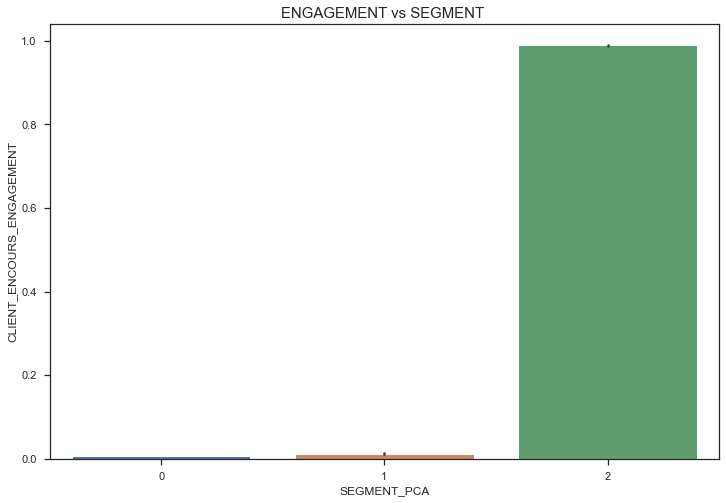

In [173]:
plt.figure(figsize=(12, 8))
sns.barplot(x=data_pca["SEGMENT_PCA"], y=data_pca["CLIENT_ENCOURS_ENGAGEMENT"])
plt.title("ENGAGEMENT vs SEGMENT ", size=15)
plt.show()

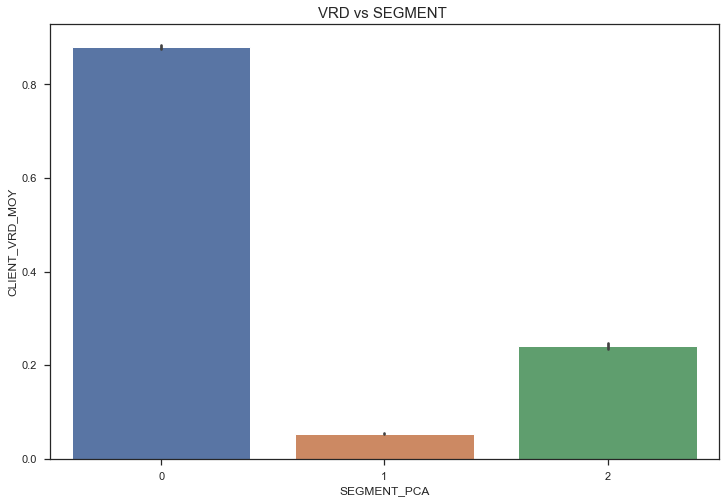

In [174]:
plt.figure(figsize=(12, 8))
sns.barplot(x=data_pca["SEGMENT_PCA"], y=data_pca["CLIENT_VRD_MOY"])
plt.title("VRD vs SEGMENT ", size=15)
plt.show()

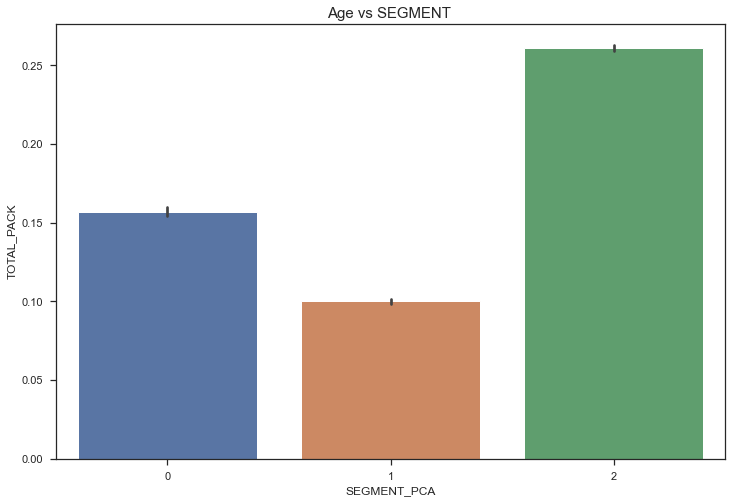

In [175]:
plt.figure(figsize=(12, 8))
sns.barplot(x=data_pca["SEGMENT_PCA"], y=data_pca["TOTAL_PACK"])
plt.title("Age vs SEGMENT ", size=15)
plt.show()

In [176]:
data_pca

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3,SEGMENT_PCA,AgeGroup
0,0.633333,0.000000,1.000000,0.6,0.258065,0.00,0.974288,0.25,0.550564,0.914327,-0.260721,-0.145008,0,Middle Aged
1,0.433333,0.145041,0.156169,0.2,0.645161,0.00,0.014642,0.25,-0.193248,-0.160433,0.025819,-0.029576,1,Middle Aged
2,0.933333,0.000000,0.453050,0.2,0.000000,0.00,1.000000,0.25,0.321793,0.866200,-0.480355,0.373832,0,Middle Aged
3,0.500000,0.000000,0.000000,0.0,0.580645,0.25,0.003033,0.00,-0.412280,-0.112597,-0.080160,0.105969,1,Middle Aged
4,0.500000,1.000000,1.000000,0.4,0.258065,0.00,0.025342,0.25,0.987932,-0.391208,-0.185449,-0.104551,2,Middle Aged
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,0.466667,0.000000,0.000000,0.0,0.064516,0.25,0.029838,0.00,-0.291437,-0.091596,-0.556527,0.118588,1,Middle Aged
49996,0.200000,0.000000,0.000000,0.2,0.645161,0.25,0.905150,0.25,-0.130126,0.577280,0.197155,-0.055443,0,NaN
49997,0.366667,0.000000,0.000000,0.2,0.645161,0.25,0.010298,0.00,-0.429549,-0.127069,-0.007747,-0.003813,1,Middle Aged
49998,0.133333,0.000000,0.000000,0.2,0.645161,0.25,0.000143,0.00,-0.441580,-0.170346,0.008444,-0.191473,1,Middle Aged


In [177]:
vis = data.sample(50000)
data_vis = pd.concat([vis.reset_index(drop=True),pd.DataFrame(pca)],axis=1)
data_vis.columns.values[-3:]=['Component 1','Component 2','Component 3']
data_vis['SEGMENT_PCA'] = kmeans_pca.labels_

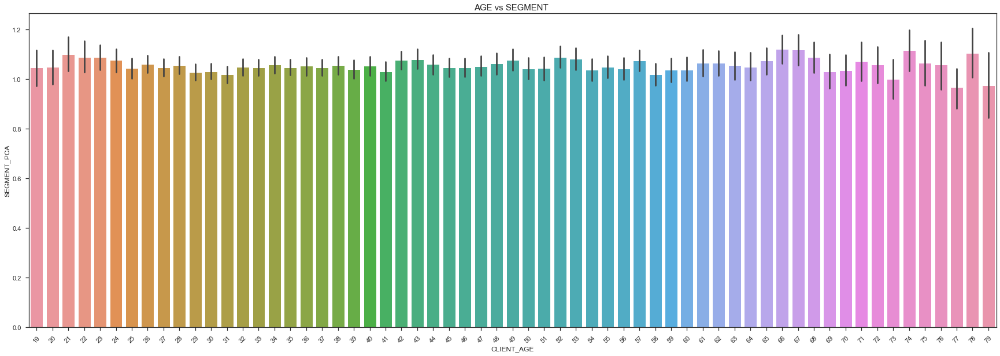

In [178]:
plt.figure(figsize=(30, 10))
sns.barplot(x=data_vis["CLIENT_AGE"], y=data_vis["SEGMENT_PCA"])
plt.title("AGE vs SEGMENT ", size=15)
plt.xticks(rotation = 45)
plt.show()

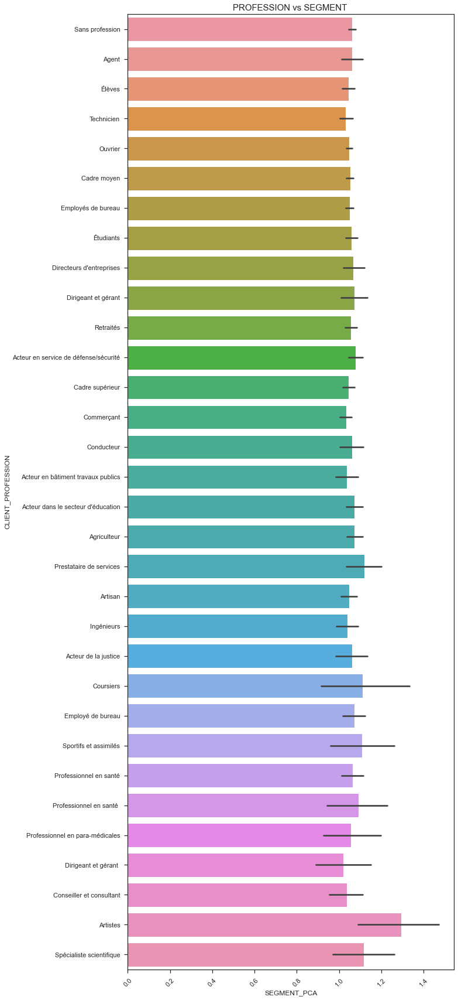

In [179]:
plt.figure(figsize=(10, 30))
sns.barplot(x=data_vis["SEGMENT_PCA"], y=data_vis["CLIENT_PROFESSION"])
plt.title("PROFESSION vs SEGMENT ", size=15)
plt.xticks(rotation = 45)
plt.show()

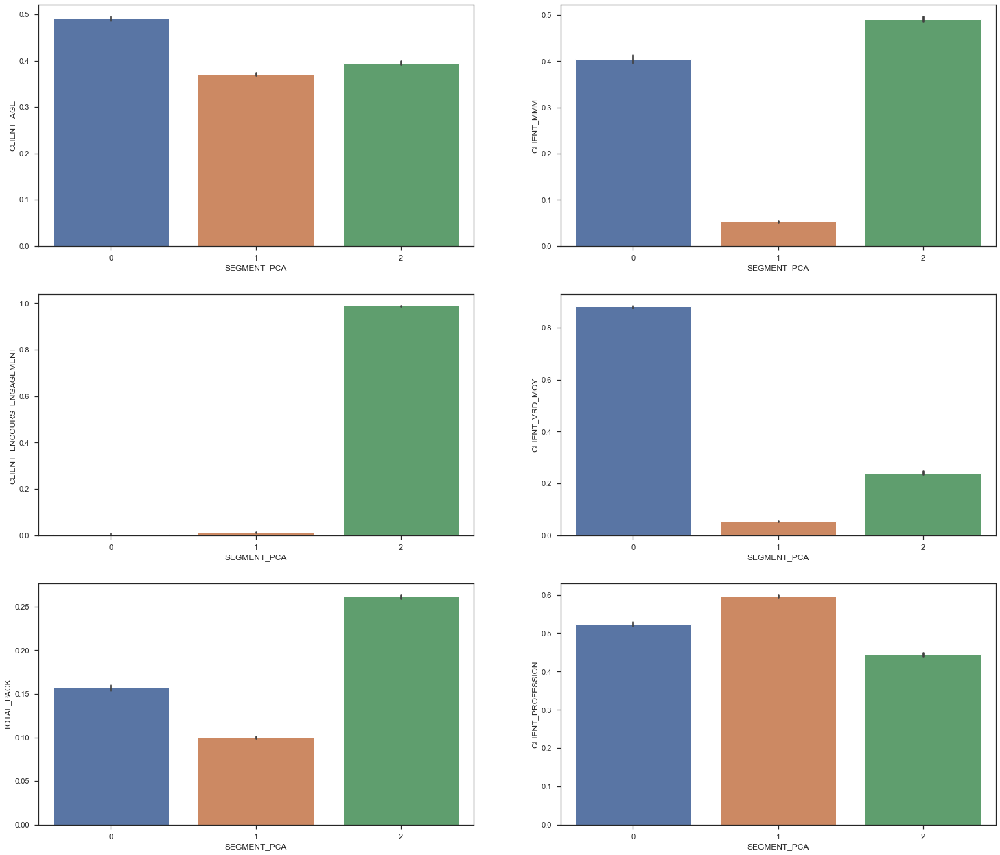

In [180]:
DColumns = data_pca[['CLIENT_AGE' ,'CLIENT_MMM' ,'CLIENT_ENCOURS_ENGAGEMENT','CLIENT_VRD_MOY','TOTAL_PACK','CLIENT_PROFESSION']]

_, ax1 = plt.subplots(3,2, figsize=(25,22))
for i, col in enumerate(DColumns):
    sns.barplot(x='SEGMENT_PCA', y=col, data=data_pca, ax=ax1[i//2, i%2])

plt.show()

In [181]:
centers = data_pca.groupby("SEGMENT_PCA").mean()

In [182]:
centers

,CLIENT_AGE,CLIENT_ENCOURS_ENGAGEMENT,CLIENT_MMM,CLIENT_NOMBRE_CARTES,CLIENT_PROFESSION,CLIENT_TYPE_DEPOSANT,CLIENT_VRD_MOY,TOTAL_PACK,0,Component 1,Component 2,Component 3
SEGMENT_PCA,,,,,,,,,,,,
0,0.491092,0.006369,0.404966,0.183222,0.524288,0.118497,0.880343,0.157099,0.116027,0.686689,0.022750,0.009755
1,0.370837,0.012067,0.053349,0.096536,0.596308,0.199150,0.053417,0.099996,-0.351171,-0.088101,-0.041153,-0.031486
2,0.395531,0.989155,0.491754,0.349494,0.444844,0.000143,0.240692,0.261202,0.716942,-0.333877,0.076866,0.064786


In [183]:
plt.rcParams['font.size'] = 14

In [184]:
colors = np.array(['red', 'green', 'blue', 'yellow'])

Text(0, 0.5, 'VRD moy')

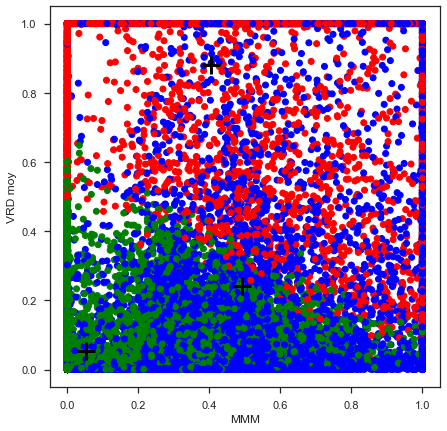

In [185]:
plt.scatter(data_pca['CLIENT_MMM'], data_pca['CLIENT_VRD_MOY'],c=colors[data_pca['SEGMENT_PCA']])
# TODO - cluster centers, marked by "+"
# Just make sure you understand this command: 
plt.scatter(centers.CLIENT_MMM, centers.CLIENT_VRD_MOY, linewidths=3, marker='+', s=300, c='black')

# TODO - always remember to add labels!
plt.xlabel("MMM")
plt.ylabel("VRD moy")

Text(0, 0.5, 'VRD moy')

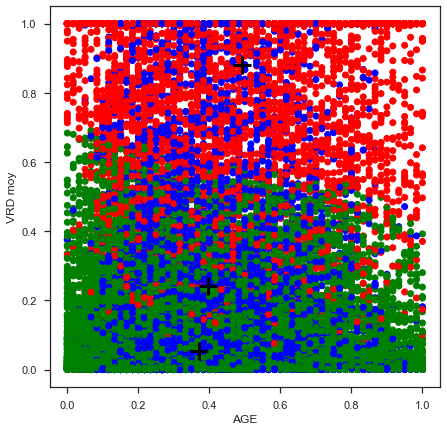

In [186]:
plt.scatter(data_pca['CLIENT_AGE'], data_pca['CLIENT_VRD_MOY'],c=colors[data_pca['SEGMENT_PCA']])
# TODO - cluster centers, marked by "+"
# Just make sure you understand this command: 
plt.scatter(centers.CLIENT_AGE, centers.CLIENT_VRD_MOY, linewidths=3, marker='+', s=300, c='black')

# TODO - always remember to add labels!
plt.xlabel("AGE")
plt.ylabel("VRD moy")

Text(0, 0.5, 'VRD moy')

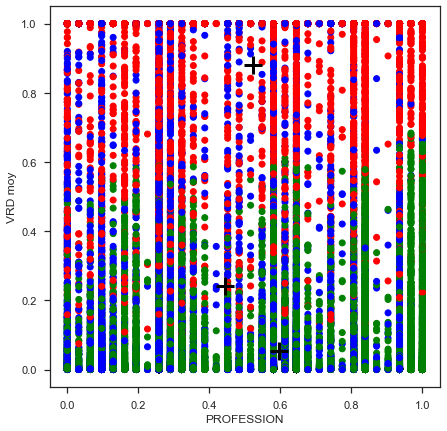

In [187]:
plt.scatter(data_pca['CLIENT_PROFESSION'], data_pca['CLIENT_VRD_MOY'],c=colors[data_pca['SEGMENT_PCA']])
# TODO - cluster centers, marked by "+"
# Just make sure you understand this command: 
plt.scatter(centers.CLIENT_PROFESSION, centers.CLIENT_VRD_MOY, linewidths=3, marker='+', s=300, c='black')

# TODO - always remember to add labels!
plt.xlabel("PROFESSION")
plt.ylabel("VRD moy")

Text(0, 0.5, 'VRD moy')

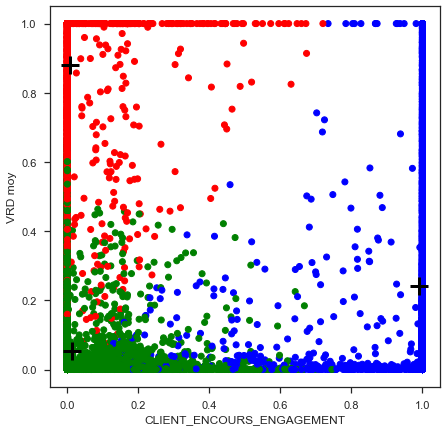

In [188]:
plt.scatter(data_pca['CLIENT_ENCOURS_ENGAGEMENT'], data_pca['CLIENT_VRD_MOY'],c=colors[data_pca['SEGMENT_PCA']])
# TODO - cluster centers, marked by "+"
# Just make sure you understand this command: 
plt.scatter(centers.CLIENT_ENCOURS_ENGAGEMENT, centers.CLIENT_VRD_MOY, linewidths=3, marker='+', s=300, c='black')

# TODO - always remember to add labels!
plt.xlabel("CLIENT_ENCOURS_ENGAGEMENT")
plt.ylabel("VRD moy")

Text(0, 0.5, 'VRD moy')

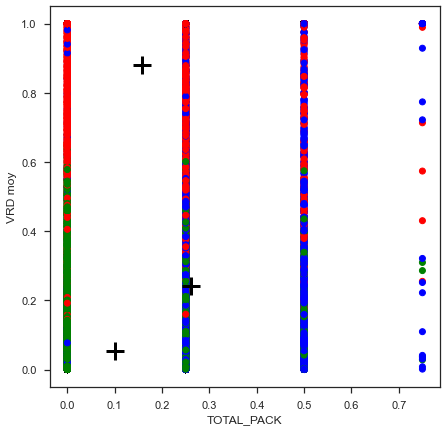

In [189]:
plt.scatter(data_pca['TOTAL_PACK'], data_pca['CLIENT_VRD_MOY'],c=colors[data_pca['SEGMENT_PCA']])
# TODO - cluster centers, marked by "+"
# Just make sure you understand this command: 
plt.scatter(centers.TOTAL_PACK, centers.CLIENT_VRD_MOY, linewidths=3, marker='+', s=300, c='black')

# TODO - always remember to add labels!
plt.xlabel("TOTAL_PACK")
plt.ylabel("VRD moy")

In [190]:
data_vis = data_vis.drop(columns=['Component 1', 'Component 2','Component 3'])

In [191]:
data_vis.to_csv(r'C:\Users\ASUS\Desktop\data.csv', index=False)

Text(0.5, 0.98, 'With 3 centroids initialized')

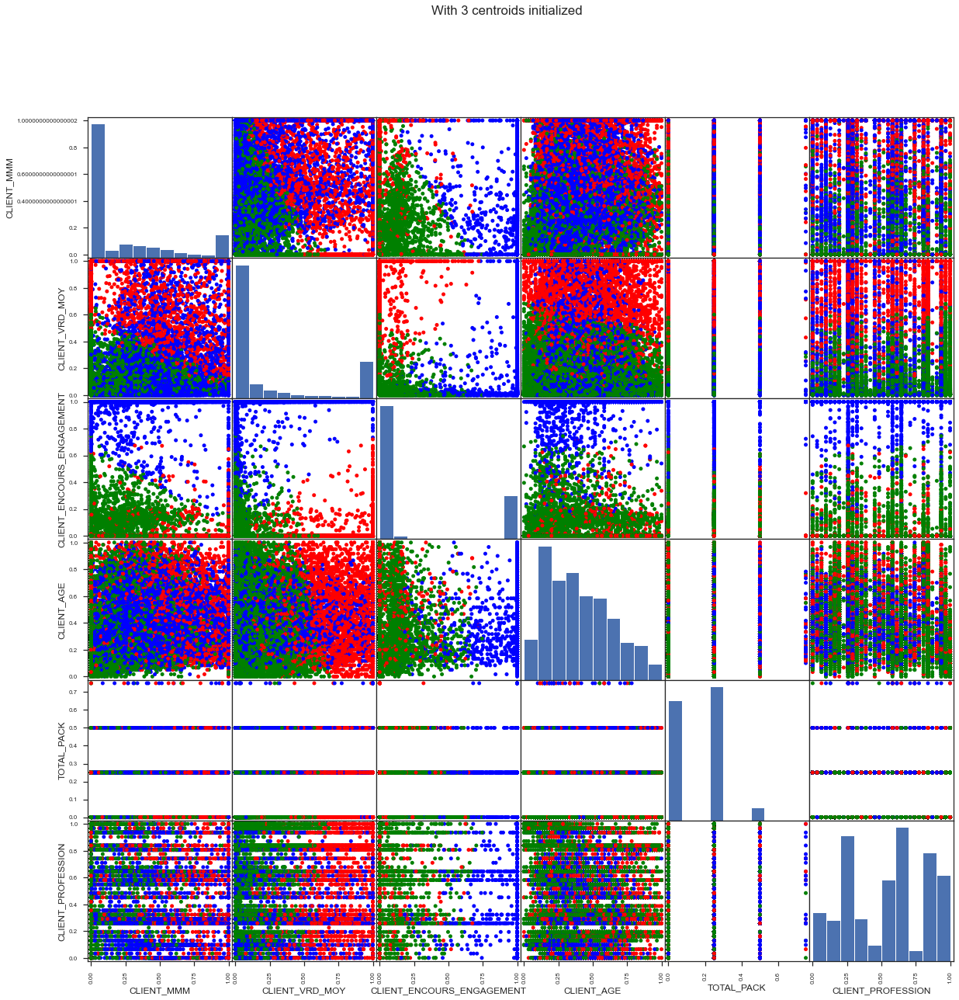

In [192]:
# Scatterplot matrix with 3 centroids initialized
from pandas.plotting import scatter_matrix
scatter_matrix(data_pca[["CLIENT_MMM","CLIENT_VRD_MOY","CLIENT_ENCOURS_ENGAGEMENT","CLIENT_AGE","TOTAL_PACK",'CLIENT_PROFESSION']],s=100, alpha=1, c=colors[data_pca["SEGMENT_PCA"]], figsize=(20,20))
plt.suptitle("With 3 centroids initialized")

#### Cluster 1 (Less active):
Relatively low average monthly flow (3980.838766) , low engagement value (5693.198826) , low average deposit value (32725.813561) with average age (51.594150) 
#### Cluster 2 (Active): 
Relatively normal average monthly flow (8620.316234) , low engagement value (26822.685970) , normal average deposit value (23745.129939) with average age  (44.007985)

#### Cluster 3 (More active): 
Relatively high average monthly flow (195454.947502) , high engagement value (104553.369407) , hight average deposit value (319753.123302) with average age  (48.560799)

